# Bins on the sphere

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

In [59]:
reduced_types_14 = [  # 'LowF',  # 1
                    'C_ar6x', 'C_ar6', 'C_ar', 'C_sp1', 'C_sp2', 'C_sp3', 'C_co2', 'C_guh',  # 8
                    'N_arp', 'N_arA', 'N_3s', 'N_1', 'N_o2', 'N_oh', 'N_amA', 'N_guh', 'N_2p', 'N_2s', 'N_3p', 'N_3t', 'N_4',  # 14
                    'O_3et', 'O_n', 'O_3ac', 'O_carb', 'O_co2', 'O_3oh', 'O_ar',  # 8
                    'S_3', 'S_r', 'S_o', 'S_o2', 'P_3', 'P_o',  # 5
                    'F_0', 'Cl_0', 'Br_0', 'I_0', 'F_i', 'Cl_i'  # 7
                    ]

amino_res_types = [  # 'X=-1',
                 'ALA','ARG', 'ASN', 'ASP', 'CYS', 'GLN',
                 'GLU', 'GLY', 'HIS', 'ILE', 'LEU', 'LYS', 'MET', 'PHE', 'PRO', 'SER',
                 'THR', 'TRP', 'TYR', 'MSE', 'VAL'
                 ]

In [2]:
# from mayavi import mlab

import pylab as pl

def mlab_show():
    arr = mlab.screenshot()
    print(arr.shape)
    pl.figure(figsize=(10,10))
    pl.imshow(arr)
    pl.axis('off')
    pl.show()

%matplotlib inline

#mlab.init_notebook(backend='ipy')

import numpy as np

# Create a sphere
#r = 1.0
#pi = np.pi
#cos = np.cos
#sin = np.sin
#phi, theta = np.mgrid[0:pi:101j, 0:2 * pi:101j]

#x = r*sin(phi)*cos(theta)
#y = r*sin(phi)*sin(theta)
#z = r*cos(phi)

#mlab.figure(bgcolor=(1, 1, 1), fgcolor=(0, 0, 0), size=(1024, 768))
#mlab.clf()

def uniform_on_sphere(n):
    x = np.random.randn(n, 3)
    x = x / np.sqrt((x ** 2).sum(axis=1))[:,np.newaxis]
    return x

data = uniform_on_sphere(1000)



# #mlab.mesh(x , y , z, color=(0.0,0.5,1.0), line_width=0.1)
# #mlab.points3d(data[:,0], data[:,1], data[:,2], scale_factor=0.05)

# mlab.figure(bgcolor=(1, 1, 1), fgcolor=(0, 0, 0), size=(1024, 768))

# bright_colors = [
#     (1, 0, 0),
#     (0, 1, 0),
#     (0, 0, 1),
#     (1, 1, 0),
#     (1, 0, 1),
#     (0, 1, 1)
# ]

# steps = 10
# step_points = 10
# for u in range(steps):
#     for v in range(steps):
#         ug = np.linspace(u / steps, (u + 1) / steps, step_points)
#         vg = np.linspace(v / steps, (v + 1) / steps, step_points)
        
#         ug, vg = np.meshgrid(ug, vg)
        
#         # θ=2πu
#         # ϕ=arccos(2v−1)
        
#         theta = 2 * np.pi * ug
#         phi = np.arccos(2 * vg - 1)
        
#         r = 1.0
#         x = r*np.sin(phi)*np.cos(theta)
#         y = r*np.sin(phi)*np.sin(theta)
#         z = r * np.cos(phi)
        
#         #print(x.shape, y.shape, z.shape)
        
#         mlab.mesh(x, y, z, color=bright_colors[(u + v) % len(bright_colors)], line_width=0.1)


# mlab_show()

In [3]:
x = uniform_on_sphere(10000)

In [4]:
def cartesian_to_spherical(x):
    # x = r*np.sin(phi)*np.cos(theta)
    # y = r*np.sin(phi)*np.sin(theta)
    # z = r * np.cos(phi)
    
    r = 1.0
    phi = np.arccos(x[:,2] / r)
    theta = np.arctan2(x[:,0], x[:,1])
    
    return phi, theta



In [5]:
def map_to_square(phi, theta):
    assert phi.max() <= np.pi + 1e-3
    assert phi.min() >= -1e-3
    
    u = theta / (2 * np.pi)
    v = (np.cos(phi) + 1) / 2
    u[u < 0] += 1
    u[u > 1] -= 1
    v[v < 0] += 1
    v[v > 1] -= 1
    return u, v

def map_to_bins(u, v, bins_per_axis):
    ub = np.clip(np.floor(u * bins_per_axis).astype(np.uint32), 0, bins_per_axis - 1)
    vb = np.clip(np.floor(v * bins_per_axis).astype(np.uint32), 0, bins_per_axis - 1)
    
    bin_idx = ub * bins_per_axis + vb
    #print(bin_idx)
    bin_counts = np.bincount(bin_idx.flatten())
    #print(bin_counts)
    assert len(bin_counts) <= bins_per_axis * bins_per_axis
    assert np.sum(bin_counts) == len(u)
    bin_counts = np.pad(bin_counts, (0, bins_per_axis * bins_per_axis - len(bin_counts)))
    return bin_counts

In [6]:
bins = map_to_bins(u, v, 10)

NameError: name 'u' is not defined

In [7]:
def uniformity_chi_stat(bins):
    num_obs = np.sum(bins)
    expected = num_obs / len(bins)
    #print('expected per bin', expected)
    return np.sum((bins - expected) ** 2 / expected), len(bins) - 1

In [8]:
def non_uniform_on_sphere(n):
    phi = np.random.uniform(0, np.pi, n)
    theta = np.random.uniform(0, np.pi * 2, n)
    # x = r*np.sin(phi)*np.cos(theta)
    # y = r*np.sin(phi)*np.sin(theta)
    # z = r * np.cos(phi)
    res = np.zeros(shape=(n, 3))
    res[:,0] = np.sin(phi) * np.cos(theta)
    res[:,1] = np.sin(phi) * np.sin(theta)
    res[:,2] = np.cos(phi)
    #print(res)
    return res

[356 189 144 132 139 144 357 339 173 122 128 123 154 355 350 145 140 135
 125 173 321 347 167 144 151 125 161 364 356 162 146 117 156 167 341 387
 153 126 115 141 160 329 337 139 141 137 126 147 414]
2239.4453999999996
KstestResult(statistic=0.07818511312619736, pvalue=1.603067238429845e-53)
p-value (~ probability is uniform): 0.0
Power_divergenceResult(statistic=2239.4453999999996, pvalue=0.0)

is uniform (strict): no
KstestResult(statistic=0.07471859204871972, pvalue=6.4395378969396355e-49)
is uniform (strict): no


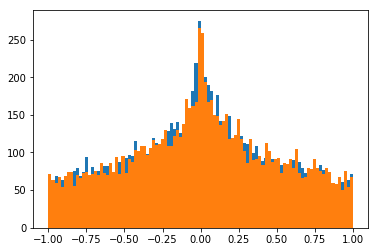

In [42]:
from scipy.stats import chi2
import scipy.stats

def do_test(verbose):
    x = non_uniform_on_sphere(10000)
    phi, theta = cartesian_to_spherical(x)
    u, v = map_to_square(phi, theta)
    bins = map_to_bins(u, v, 7)
    chi_stat, dof = uniformity_chi_stat(bins)
    if verbose:
        print(bins)
        print(chi_stat)
    plt.hist(x[:,0], bins=100)
    print(scipy.stats.kstest(x[:,0], scipy.stats.uniform(loc=-1, scale=2).cdf))

    # probability of failure when rejecting the null hypothesis 'it is uniform' when it is true
    p_value = 1 - chi2.cdf(chi_stat, dof)
    if verbose:
        print('p-value (~ probability is uniform):', p_value)
        print(scipy.stats.chisquare(bins))
        print()

    print('is uniform (strict):', ('yes' if p_value > 0.01 else 'no'))
    
do_test(True)

for i in range(1):
    do_test(False)

# Reference uniform distribution

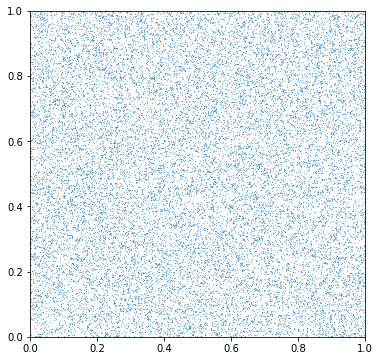

In [16]:
n = 20000
x = uniform_on_sphere(n)
phi, theta = cartesian_to_spherical(x)
u, v = map_to_square(phi, theta)
plot_square(u, v)

# Reference non-uniform distribution (($\psi, \theta$)-uniform)

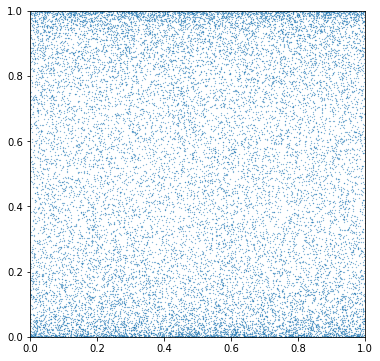

In [17]:
x = non_uniform_on_sphere(20000)
phi, theta = cartesian_to_spherical(x)
u, v = map_to_square(phi, theta)

plot_square(u, v)


# Real distribution plots

In [12]:
import os
import array

data_path = '/media/hdd1/data/pdbbind/2016/korp_stats_nonames.bin'
double_size = 8

n_nums = int(os.path.getsize(data_path)/double_size)
n_content = 5
if n_nums % n_content != 0:
    print("Oops, something went wrong with the file size and contents.")
n_entries = int(n_nums/n_content)
F = open(data_path, 'rb')
data = array.array('d')
data.fromfile(F, n_nums)
F.close()
data = np.array(data)
data = np.reshape(data, (n_entries, n_content))
print(np.shape(data))

(47916041, 5)


In [13]:
data[:5]

array([[10.        , 13.        , 18.35012272,  2.84635897,  3.58099849],
       [11.        , 13.        , 19.58776331,  0.94729078,  2.65130192],
       [ 1.        , 13.        , 16.27541755,  2.57432665,  2.69985052],
       [14.        , 13.        , 16.11988392,  1.16478043,  4.83862683],
       [10.        , 13.        , 12.37842154,  1.00788748,  2.3572276 ]])

0. protein residue type (it was originally an int)

1.  ligand atom type (it was originally an int) 

2. distance

3. theta angle (between the vector and Z, 0-pi)

4. psi angle (between the vector projection and X, 0-2pi)


In [14]:
data_local = data[np.where((data[:, 0] == 0.) & (data[:, 1] == 4.))][:, 2:]

In [15]:
def plot_square(u, v):
    plt.figure(figsize=(6,6))
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.scatter(u, v, s=1000.0 / len(u))
    plt.show()


In [102]:
def plot_for_distance_range(data, d_min, d_max):
    data_local = data[np.where(
        (data[:, 2] > d_min) & (data[:, 2] <= d_max))
    ][:, 3:]
    
    #print(data_local.shape[0])
    if data_local.shape[0] < 10:
        return
        
    u, v = map_to_square(data_local[:,0], data_local[:,1])
    bins = map_to_bins(u, v, 3)
    #print(bins)
    chi_stat, dof = uniformity_chi_stat(bins)

    #p_value = 1 - chi2.cdf(chi_stat, dof)
    
    p_value = scipy.stats.chisquare(bins).pvalue
    print('Distance ({};{}]:'.format(d_min, d_max), '{} values'.format(np.sum(bins)), 'bins', bins, 'p-value', p_value)
    #print('p-value (~ probability is uniform):', p_value)
    #print(scipy.stats.chisquare(bins))
    #print()
    #print('is uniform (strict):', ('yes' if p_value > 0.01 else 'no'))

    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.text(0.1, 0.85, '({},{}]'.format(d_min, d_max), color='fuchsia', fontsize=20)
    plt.scatter(u, v, s=100.0 / len(u))
    
def plot_for_pair(a, b):
    plt.figure(figsize=(15, 15))
    sub_data = data[np.where(
            (data[:, 0] == a) &
            (data[:, 1] == b))
        ][:,:]
    a_t = '({0})'.format(amino_res_types[a])
    l_t = '({0})'.format(reduced_types_14[b])
    print('Got', sub_data.shape[0], 'values of', data.shape[0], 'for pair', a, a_t, '-', b, l_t)
    for d in range(2, 20):
        plt.subplot(5, 4, 1 + d)
        plot_for_distance_range(sub_data, d, d + 1)
    plt.show()

def plot_for_protein(a):
    plt.figure(figsize=(15, 15))
    sub_data = data[np.where(
            (data[:, 0] == a))
        ][:,:]
    a_t = '({0})'.format(amino_res_types[a])
    print('Got', sub_data.shape[0], 'values of', data.shape[0], 'for protein type', a, a_t)
    for d in range(2, 20):
        plt.subplot(5, 4, 1 + d)
        plot_for_distance_range(sub_data, d, d + 1)
    plt.show()

def plot_for_ligand(a):
    plt.figure(figsize=(15, 15))
    sub_data = data[np.where(
            (data[:, 1] == a))
        ][:,:]
    l_t = '({0})'.format(reduced_types_14[a])
    print('Got', sub_data.shape[0], 'values of', data.shape[0], 'for ligand type', a, l_t)
    for d in range(2, 20):
        plt.subplot(5, 4, 1 + d)
        plot_for_distance_range(sub_data, d, d + 1)
    plt.show()
    
    #plot_square(u, v)
    
#plot_for_distance_range(0, 0, 1, 4)
#plot_for_distance_range(0, 0, 4, 10)
#plot_for_distance_range(0, 0, 10, 20)

# Pair 0 - 0

Got 687016 values of 47916041 for pair 0 (ALA) - 0 (C_ar6x)
Distance (3;4]: 1030 values bins [509 157  31 299   9   0  16   6   3] p-value 0.0
Distance (4;5]: 6283 values bins [1617  390  177 1644  583   72 1147  442  211] p-value 0.0
Distance (5;6]: 10863 values bins [1432  872  314 1746 1333  422 3322 1013  409] p-value 0.0
Distance (6;7]: 13758 values bins [1809 1625  716 2004 1539  684 3367 1288  726] p-value 0.0
Distance (7;8]: 18457 values bins [2529 2016 1878 2372 1701 1096 3692 1621 1552] p-value 0.0
Distance (8;9]: 24424 values bins [2440 2930 2901 2615 2160 1900 4774 2357 2347] p-value 0.0
Distance (9;10]: 32468 values bins [2773 3910 4011 2936 3290 2681 5751 3844 3272] p-value 0.0
Distance (10;11]: 40460 values bins [3274 4394 4837 3843 4122 3343 6368 5530 4749] p-value 0.0
Distance (11;12]: 44812 values bins [3697 4406 5404 4594 3868 3751 6012 6162 6918] p-value 0.0
Distance (12;13]: 50322 values bins [4105 5092 5617 5288 3998 5217 6161 6827 8017] p-value 0.0
Distance (13;1

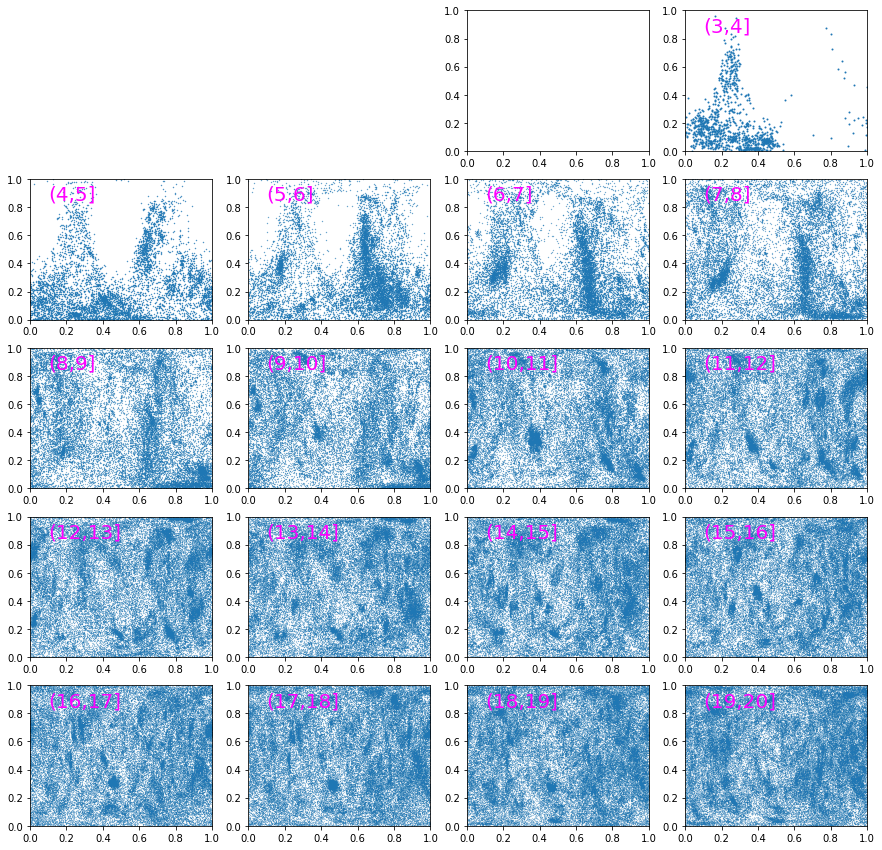

In [63]:
plot_for_pair(0, 0)


# Pair 0 - 1

Got 78659 values of 47916041 for pair 8 (HIS) - 23 (O_3ac)
Distance (3;4]: 215 values bins [85 61  0 50  3  0  1  0 15] p-value 2.0632037857131934e-72
Distance (4;5]: 266 values bins [26  3 32 50 21  3 80 41 10] p-value 2.7427862058506895e-32
Distance (5;6]: 767 values bins [ 99  80  29  94  46  31 292  67  29] p-value 4.703924176164441e-132
Distance (6;7]: 1667 values bins [335 191  64 190 177 254 221 133 102] p-value 4.5652872964008236e-57
Distance (7;8]: 2842 values bins [293 172 133 486 227 135 812 218 366] p-value 3.730228209394439e-256
Distance (8;9]: 2814 values bins [337 188 278 330 378 170 618 321 194] p-value 2.7566991853161295e-98
Distance (9;10]: 4879 values bins [ 450  292  593  530  458  337 1083  744  392] p-value 2.4124935349667474e-185
Distance (10;11]: 5336 values bins [ 585  324  481  660  475  349 1193  776  493] p-value 6.5136088931983076e-201
Distance (11;12]: 5549 values bins [547 446 497 692 680 433 980 846 428] p-value 3.7989668015222463e-104
Distance (12;13]: 

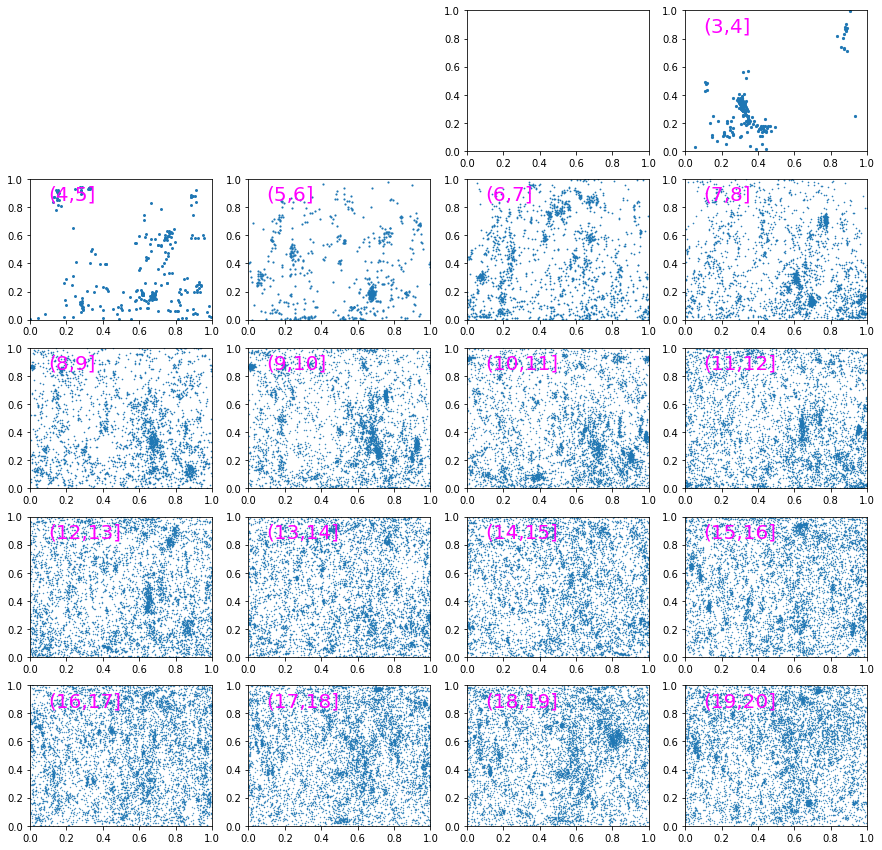

In [82]:
plot_for_pair(0, 1)

# Histidine -- Oxygene (probably negatively charged)

Got 42941 values of 47916041 for pair 8 (HIS) - 25 (O_co2)
Distance (3;4]: 128 values bins [53 16  0 45  4  0  1  7  2] p-value 2.8390926003439446e-46
Distance (4;5]: 352 values bins [ 60   7  15 125  49   1  16  78   1] p-value 4.627111960052859e-75
Distance (5;6]: 378 values bins [71 19 16 81 42  8 90 33 18] p-value 2.4688074264919316e-35
Distance (6;7]: 1283 values bins [124  60  50 329 229  60 219 166  46] p-value 9.315390272795743e-117
Distance (7;8]: 1677 values bins [142  74  78 451 129  56 413 260  74] p-value 3.046502400052885e-210
Distance (8;9]: 1655 values bins [192  98 179 279 172  90 301 229 115] p-value 1.7566535419852683e-49
Distance (9;10]: 2166 values bins [223 119 177 353 216 177 450 254 197] p-value 4.200886649574019e-69
Distance (10;11]: 2627 values bins [255 202 168 479 251 211 549 278 234] p-value 8.530370269104687e-97
Distance (11;12]: 2734 values bins [238 178 198 439 297 258 526 339 261] p-value 2.7344159670522684e-69
Distance (12;13]: 2903 values bins [336 21

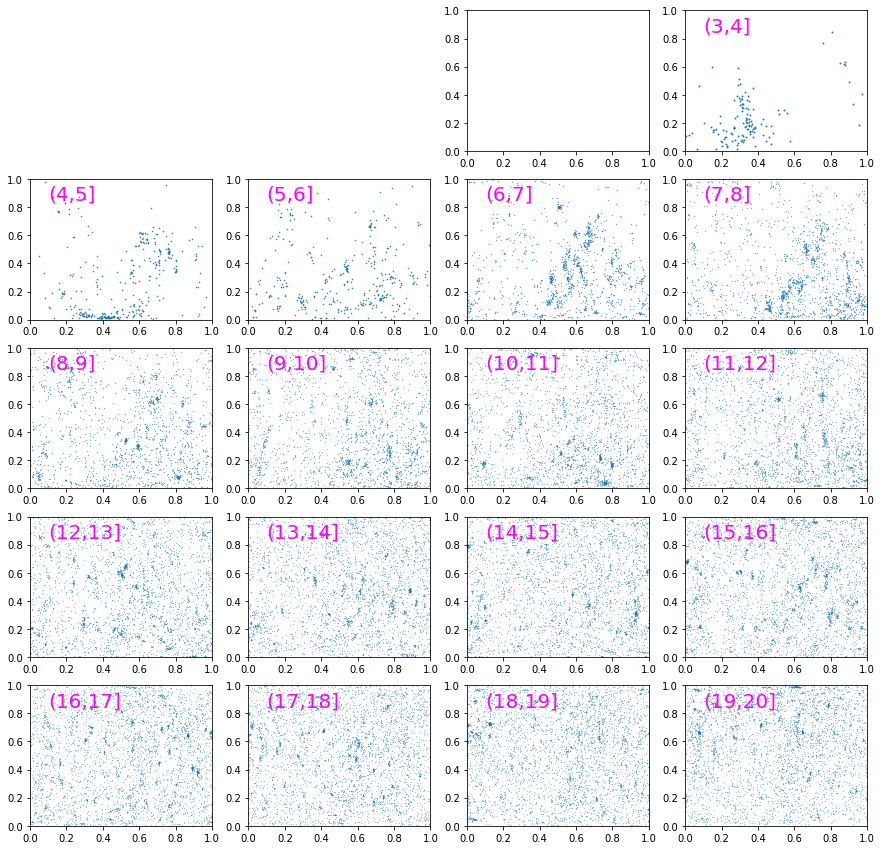

In [121]:
plot_for_pair(amino_res_types.index('HIS'), reduced_types_14.index('O_co2'))

# Top uniform distributions

In [48]:
def get_uniformity_pvalue(data, a, b):
    data_local = data[np.where(
        (data[:, 0] == a) & (data[:, 1] == b)
    )][:, 3:]
    
    if data_local.shape[0] < 10:
        return 0, 0
        
    u, v = map_to_square(data_local[:,0], data_local[:,1])
    bins = map_to_bins(u, v, 3)
    #print(bins)
    chi_stat, dof = uniformity_chi_stat(bins)
    
    p_value = scipy.stats.chisquare(bins).pvalue
    print('Pair', a, b, ' num values', np.sum(bins), 'p-value:', p_value)
    
    return np.sum(bins), p_value

data_inf = data[np.where(
        (data[:, 2] > 16) & (data[:, 2] <= 20))]

top_p_values = []


for a in range(21):
    for b in range(40):
        num_values, p_value = get_uniformity_pvalue(data_inf, a, b)
        top_p_values.append((p_value, num_values, a, b))

top_p_values = sorted(top_p_values)[::-1]

Pair 0 0  num values 272654 p-value: 0.0
Pair 0 1  num values 44781 p-value: 0.0
Pair 0 2  num values 2313 p-value: 2.1174192289168374e-24
Pair 0 3  num values 81291 p-value: 0.0
Pair 0 4  num values 396924 p-value: 0.0
Pair 0 5  num values 20269 p-value: 2.4524883901262254e-123
Pair 0 6  num values 4605 p-value: 9.238343559954623e-94
Pair 0 7  num values 23783 p-value: 3.977830077106826e-161
Pair 0 8  num values 35741 p-value: 1.3333208692326025e-290
Pair 0 9  num values 3220 p-value: 4.19624029894579e-50
Pair 0 10  num values 1305 p-value: 4.406683772833929e-21
Pair 0 11  num values 864 p-value: 0.004403265426143217
Pair 0 12  num values 1348 p-value: 4.907857114677696e-10
Pair 0 13  num values 75308 p-value: 0.0
Pair 0 14  num values 12760 p-value: 9.22661189274561e-196
Pair 0 15  num values 237 p-value: 1.830221416974173e-12
Pair 0 16  num values 1298 p-value: 5.819253841727961e-14
Pair 0 17  num values 264 p-value: 0.030346608896084867
Pair 0 18  num values 1067 p-value: 8.5216866

Pair 3 38  num values 37 p-value: 0.0056672082302453046
Pair 4 0  num values 79368 p-value: 0.0
Pair 4 1  num values 13472 p-value: 4.222770424729134e-144
Pair 4 2  num values 715 p-value: 2.2518542197231067e-12
Pair 4 3  num values 24183 p-value: 4.35047110206774e-298
Pair 4 4  num values 111121 p-value: 0.0
Pair 4 5  num values 4684 p-value: 2.0778235874565064e-46
Pair 4 6  num values 1790 p-value: 5.2115665202674864e-108
Pair 4 7  num values 6253 p-value: 2.944417954958869e-44
Pair 4 8  num values 10272 p-value: 4.4315134841209954e-120
Pair 4 9  num values 742 p-value: 4.5819867323839936e-23
Pair 4 10  num values 428 p-value: 2.0416490328093454e-08
Pair 4 11  num values 173 p-value: 0.0004242680739572285
Pair 4 12  num values 252 p-value: 3.548051572964365e-13
Pair 4 13  num values 22724 p-value: 1.1256541500833622e-257
Pair 4 14  num values 4987 p-value: 8.352448117643869e-172
Pair 4 15  num values 141 p-value: 9.289487133253738e-21
Pair 4 16  num values 303 p-value: 1.235888305323

Pair 8 0  num values 115821 p-value: 0.0
Pair 8 1  num values 19509 p-value: 0.0
Pair 8 2  num values 1020 p-value: 1.9437702491389713e-14
Pair 8 3  num values 29579 p-value: 1.6092403167629493e-167
Pair 8 4  num values 135328 p-value: 0.0
Pair 8 5  num values 5726 p-value: 4.8327258191938495e-23
Pair 8 6  num values 1749 p-value: 1.0473769446123597e-51
Pair 8 7  num values 9225 p-value: 5.3109293493931425e-199
Pair 8 8  num values 16349 p-value: 0.0
Pair 8 9  num values 1040 p-value: 3.6193748392926555e-13
Pair 8 10  num values 600 p-value: 5.383207599481238e-15
Pair 8 11  num values 334 p-value: 1.699322637290259e-05
Pair 8 12  num values 357 p-value: 1.2444425670650804e-19
Pair 8 13  num values 29062 p-value: 1.8016637146304558e-297
Pair 8 14  num values 4929 p-value: 1.3543465980062132e-105
Pair 8 15  num values 84 p-value: 4.312057111604797e-05
Pair 8 16  num values 475 p-value: 3.5678055424088025e-11
Pair 8 17  num values 92 p-value: 0.09707776163172373
Pair 8 18  num values 395 

Pair 11 37  num values 29 p-value: 0.0013770067946063834
Pair 11 38  num values 46 p-value: 0.08522914105975064
Pair 12 0  num values 113337 p-value: 0.0
Pair 12 1  num values 18531 p-value: 0.0
Pair 12 2  num values 864 p-value: 4.9851022613251274e-21
Pair 12 3  num values 28386 p-value: 2.6511959342344648e-301
Pair 12 4  num values 143269 p-value: 0.0
Pair 12 5  num values 6287 p-value: 6.442074982054067e-65
Pair 12 6  num values 1795 p-value: 3.220899244090337e-61
Pair 12 7  num values 9218 p-value: 5.048712247907414e-186
Pair 12 8  num values 15142 p-value: 0.0
Pair 12 9  num values 1079 p-value: 5.837998147095452e-40
Pair 12 10  num values 557 p-value: 5.992569262665484e-10
Pair 12 11  num values 301 p-value: 1.4342673454694735e-06
Pair 12 12  num values 419 p-value: 0.011258097073356541
Pair 12 13  num values 27151 p-value: 1.4329655226307289e-291
Pair 12 14  num values 4561 p-value: 5.062115643162486e-157
Pair 12 15  num values 101 p-value: 1.6560573835737727e-19
Pair 12 16  num

Pair 15 32  num values 7606 p-value: 9.66635427757173e-64
Pair 15 33  num values 10977 p-value: 3.680565409265038e-126
Pair 15 34  num values 5283 p-value: 3.0127644397832497e-91
Pair 15 35  num values 1202 p-value: 2.340912337951429e-07
Pair 15 36  num values 618 p-value: 1.2156806015643339e-09
Pair 15 37  num values 29 p-value: 0.4402357755463111
Pair 15 38  num values 24 p-value: 0.48376738155368726
Pair 16 0  num values 244033 p-value: 0.0
Pair 16 1  num values 37073 p-value: 0.0
Pair 16 2  num values 1544 p-value: 1.3857384689927764e-21
Pair 16 3  num values 69584 p-value: 0.0
Pair 16 4  num values 337531 p-value: 0.0
Pair 16 5  num values 14399 p-value: 4.235203041182995e-156
Pair 16 6  num values 4305 p-value: 2.250271973452941e-144
Pair 16 7  num values 17306 p-value: 4.1397730862450365e-209
Pair 16 8  num values 28245 p-value: 0.0
Pair 16 9  num values 2762 p-value: 3.1102008712569474e-40
Pair 16 10  num values 987 p-value: 1.3932426715225944e-14
Pair 16 11  num values 660 p-v

Pair 20 8  num values 39299 p-value: 2.35588182625594e-255
Pair 20 9  num values 3485 p-value: 2.2346820627185425e-50
Pair 20 10  num values 1608 p-value: 0.00010058647792890808
Pair 20 11  num values 868 p-value: 0.0003288196756250065
Pair 20 12  num values 1422 p-value: 1.152209246662758e-14
Pair 20 13  num values 88760 p-value: 0.0
Pair 20 14  num values 15300 p-value: 2.6207304377247373e-52
Pair 20 15  num values 273 p-value: 2.0224210933780715e-16
Pair 20 16  num values 1350 p-value: 9.127764220211796e-06
Pair 20 17  num values 255 p-value: 0.037297905960335616
Pair 20 18  num values 1469 p-value: 1.3253039798681491e-27
Pair 20 19  num values 19641 p-value: 1.0441023518751814e-54
Pair 20 20  num values 45363 p-value: 2.980644620361468e-168
Pair 20 21  num values 1720 p-value: 5.289766442544844e-07
Pair 20 22  num values 1270 p-value: 1.1985210526860273e-16
Pair 20 23  num values 95625 p-value: 0.0
Pair 20 24  num values 72877 p-value: 1.163506955391264e-297
Pair 20 25  num values 

In [369]:
top_p_values_with_many_points = [t for t in top_p_values if t[1] > 500]

for t in top_p_values_with_many_points[:10]:
    print(t)

(0.005289038550617875, 1790, 20, 34)
(0.0003667729609617166, 1220, 20, 27)
(1.4303682661028368e-05, 1004, 15, 27)
(4.101004012022975e-06, 1336, 0, 27)
(3.6692883577568982e-06, 556, 18, 9)
(3.4061003846108764e-06, 504, 10, 16)
(2.9146996135179107e-06, 708, 0, 2)
(7.269546900824107e-07, 1426, 8, 19)
(7.084211169632459e-07, 575, 7, 2)
(1.1937776607717386e-07, 902, 10, 2)


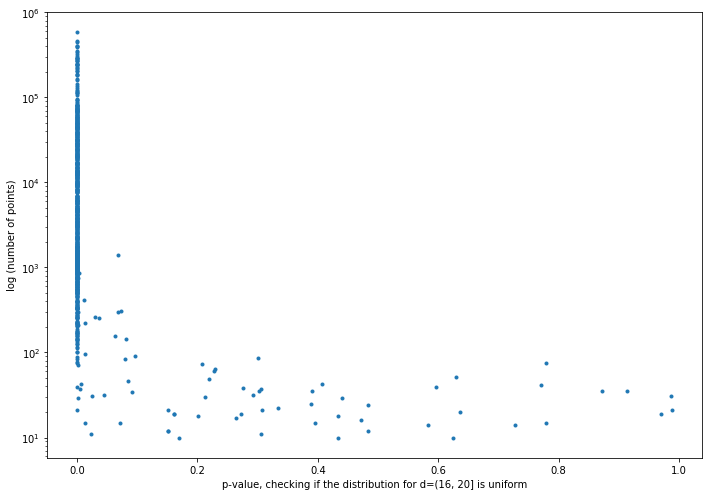

In [49]:
plt.plot(np.array(top_p_values)[:, 0], np.array(top_p_values)[:, 1], '.')
plt.yscale('log')
plt.xlabel('p-value, checking if the distribution for d=(16, 20] is uniform')
plt.ylabel('log (number of points)')
plt.gcf().set_size_inches((10, 7))
plt.tight_layout()
plt.savefig('/home/maria/Dropbox/lab/mipt/ligandsextractor/korp6d/plotted_16_20.png')

# Pair 20 - 34

In [119]:
plot_for_pair(20, 34)

# Pair 20 - 27

In [118]:
plot_for_pair(20, 27)

# Pair 15 - 27

Got 9576 values of 47916041 for pair 15 - 27
Distance (4;5]: 38 values bins [ 9  1  1 10  5  0  8  4  0] p-value 0.00019400795654445085
Distance (5;6]: 90 values bins [11  1  5  7 11  2 31 20  2] p-value 9.349867988736508e-14
Distance (6;7]: 108 values bins [11 12  8  5  5  9 38 17  3] p-value 3.916777449157565e-13
Distance (7;8]: 291 values bins [43 32 31 30 25 39 45 26 20] p-value 0.023668554283556218
Distance (8;9]: 377 values bins [34 37 40 20 30 51 69 64 32] p-value 3.292547829853806e-08
Distance (9;10]: 508 values bins [26 44 67 34 89 42 74 66 66] p-value 2.669825195423574e-10
Distance (10;11]: 500 values bins [57 49 40 33 70 54 67 75 55] p-value 0.0006294014400336462
Distance (11;12]: 673 values bins [ 53  57  91  61  73  53  96 116  73] p-value 1.8388558697389468e-08
Distance (12;13]: 770 values bins [ 63  56  85  56 101  80 117  94 118] p-value 6.277017168426747e-09
Distance (13;14]: 790 values bins [ 77  79  71  78 111  80  71 138  85] p-value 3.145382231731858e-07
Distance (

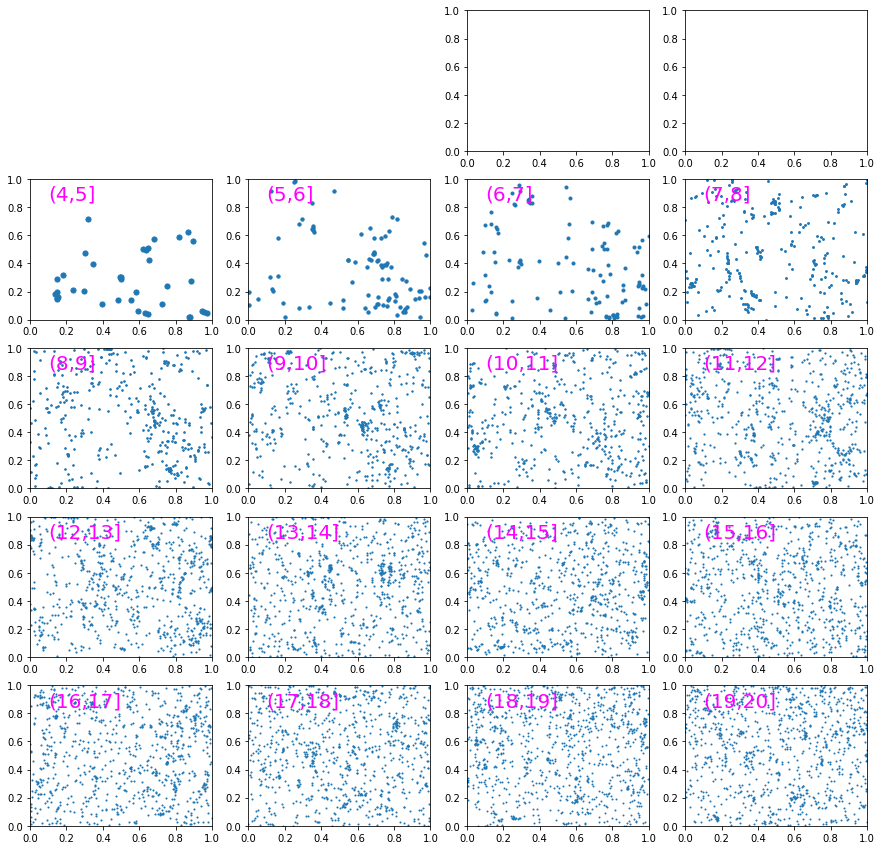

In [372]:
plot_for_pair(15, 27)

# More pictures for pair 0 - 1

In [115]:
print(data_local.shape)

for d in range(2, 20, 4):
    data_dist = data_local[data_local[:,0] > d][:,:]
    print(data_dist.shape)

    u, v = map_to_square(data_dist[:,1], data_dist[:,2])
    bins = map_to_bins(u, v, 4)
    print(bins)
    chi_stat, dof = uniformity_chi_stat(bins)

    p_value = 1 - chi2.cdf(chi_stat, dof)
    print('p-value (~ probability is uniform):', p_value)
    print(scipy.stats.chisquare(bins))
    print()
    print('is uniform (strict):', ('yes' if p_value > 0.01 else 'no'))

    plot_square(u, v)

# Amino acid - all ligand types
The distributions at 20 A look very different

Got 2131963 values of 47916041 for protein type 1 (ARG)
Distance (3;4]: 1355 values bins [492 181  62 232  26   1  11 187 163] p-value 2.510492502331671e-268
Distance (4;5]: 5732 values bins [1540  572  379  970  437   93  334  874  533] p-value 0.0
Distance (5;6]: 12518 values bins [1970 1115  824 2029 1305  648 1552 2008 1067] p-value 0.0
Distance (6;7]: 20041 values bins [2406 1929 1807 2739 2129 1554 3135 2856 1486] p-value 2.732230792545859e-265
Distance (7;8]: 33903 values bins [3806 3057 4159 3750 3534 2816 4972 4196 3613] p-value 1.5098574618863867e-182
Distance (8;9]: 58410 values bins [5766 4877 7367 5339 6040 5618 8050 7521 7832] p-value 0.0
Distance (9;10]: 88010 values bins [ 7021  6867 10864  7482  9409  8144 12778 11997 13448] p-value 0.0
Distance (10;11]: 113118 values bins [ 8705  8437 14165 10021 12034 10909 15061 17941 15845] p-value 0.0
Distance (11;12]: 132921 values bins [10906 10810 17864 10722 13694 13793 16819 20180 18133] p-value 0.0
Distance (12;13]: 147525 v

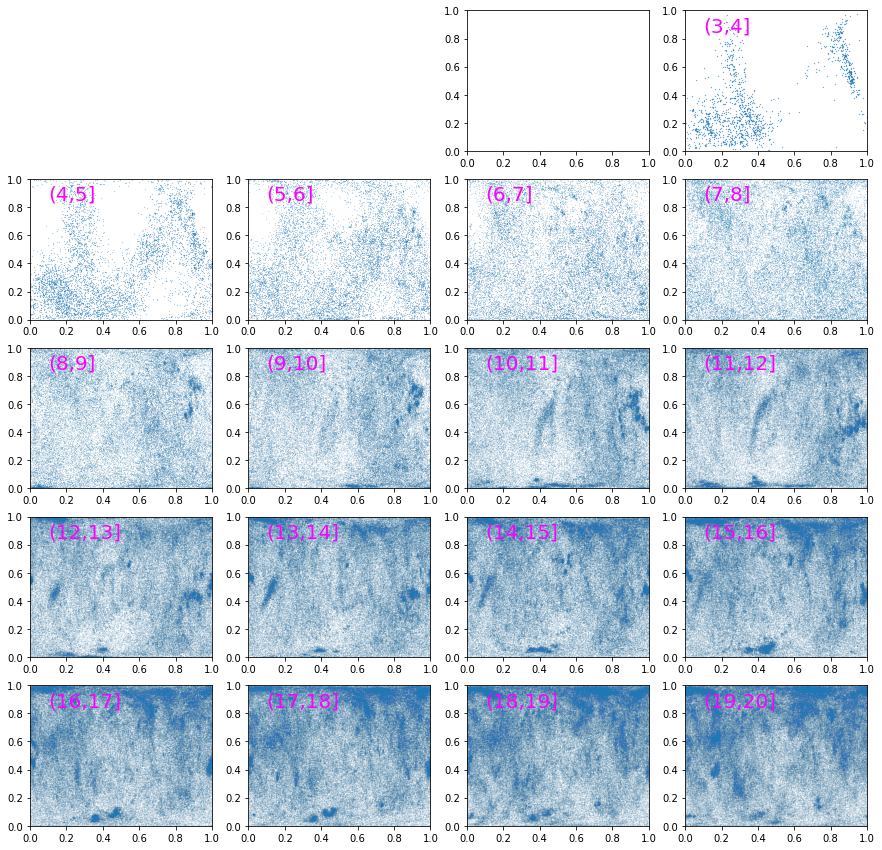

Got 2326984 values of 47916041 for protein type 11 (LYS)
Distance (3;4]: 1464 values bins [554 191  67 224  18   1  18 183 208] p-value 1.0210993293826e-309
Distance (4;5]: 6490 values bins [1451  674  380  966  387   86  836  935  775] p-value 0.0
Distance (5;6]: 12474 values bins [1885 1085  926 1646 1111  553 2526 1713 1029] p-value 0.0
Distance (6;7]: 23623 values bins [2641 1931 2003 2694 2027 1308 6917 2476 1626] p-value 0.0
Distance (7;8]: 44770 values bins [ 7988  3297  5171  4003  3835  2663 10636  3869  3308] p-value 0.0
Distance (8;9]: 72673 values bins [12007  5730 10346  5537  7769  6084 11473  7386  6341] p-value 0.0
Distance (9;10]: 102656 values bins [12565  8997 13539  6894 13107 10575 11959 13726 11294] p-value 0.0
Distance (10;11]: 125309 values bins [11834 11754 17694  8665 17985 13629 11463 14610 17675] p-value 0.0
Distance (11;12]: 145601 values bins [11778 14794 23555  9976 19031 17566 11524 14645 22732] p-value 0.0
Distance (12;13]: 161744 values bins [13313 170

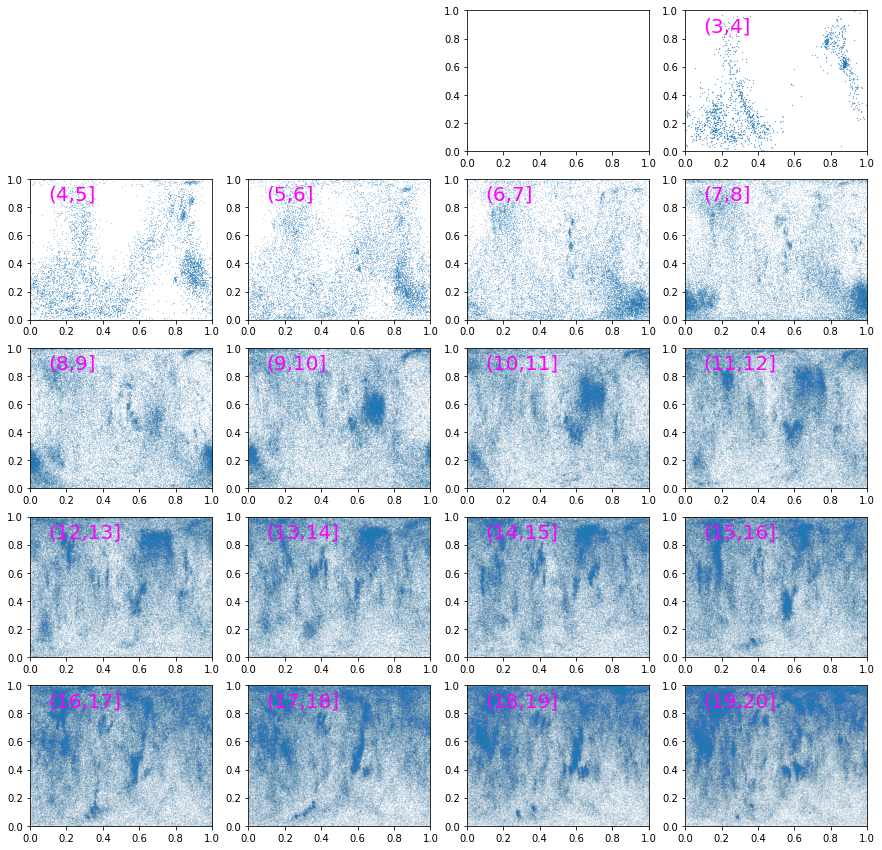

Got 1627866 values of 47916041 for protein type 5 (GLN)
Distance (3;4]: 1736 values bins [743 433  81 218  36   0  38  72 115] p-value 0.0
Distance (4;5]: 7111 values bins [2050 1783  462  840  478  103  431  539  425] p-value 0.0
Distance (5;6]: 13180 values bins [2614 2370  830 1685 1368  737 1430 1257  889] p-value 0.0
Distance (6;7]: 19231 values bins [3355 2604 1449 2551 1985 1285 2513 2003 1486] p-value 0.0
Distance (7;8]: 33287 values bins [5152 3614 3701 3772 3188 2388 4934 3075 3463] p-value 0.0
Distance (8;9]: 51365 values bins [6862 4821 7188 4934 5702 4612 6471 5236 5539] p-value 2.6360088694105563e-257
Distance (9;10]: 65752 values bins [8159 6154 8814 5990 8303 7087 7296 6756 7193] p-value 7.2317578733977605e-214
Distance (10;11]: 76295 values bins [8384 7235 9997 6480 9181 9346 8516 8203 8953] p-value 3.8036418885455573e-234
Distance (11;12]: 88272 values bins [ 9455  8353 11325  7995 10520 10722  9683  8917 11302] p-value 1.5705248143453158e-263
Distance (12;13]: 102037

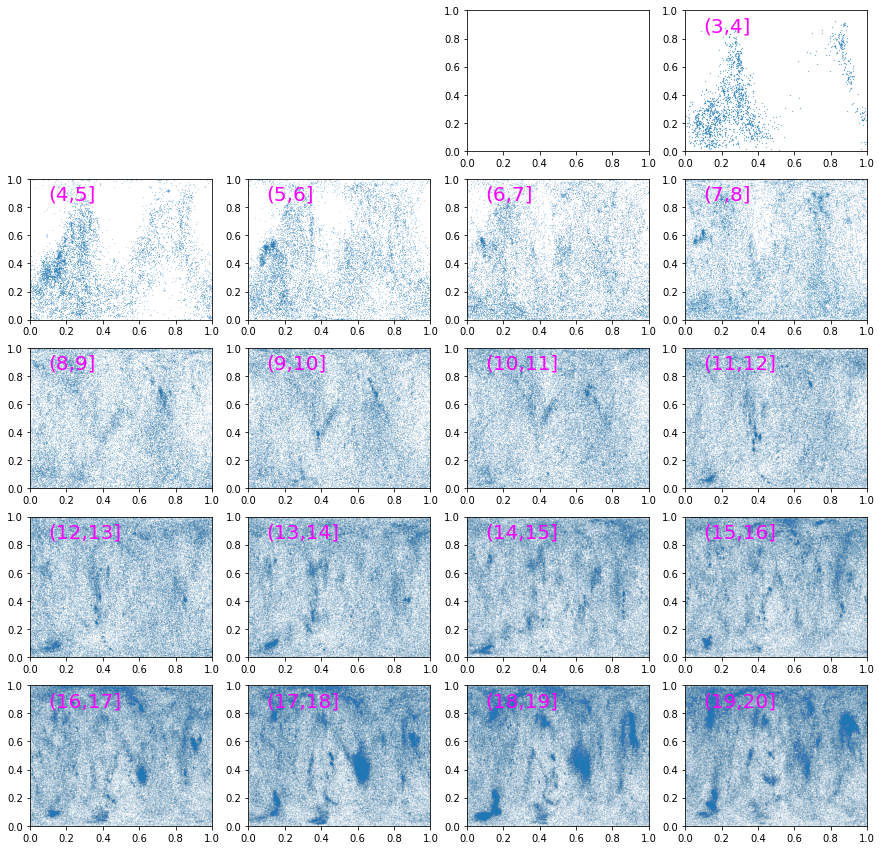

Got 1944783 values of 47916041 for protein type 2 (ASN)
Distance (3;4]: 1653 values bins [513 445  64 262  42   1  17 164 145] p-value 0.0
Distance (4;5]: 8507 values bins [2445 1214  338 1516  887   90  591  924  502] p-value 0.0
Distance (5;6]: 18145 values bins [4458 2183  895 3332 1691  551 2247 1943  845] p-value 0.0
Distance (6;7]: 31407 values bins [7177 3441 1564 4905 2075 1302 5951 3423 1569] p-value 0.0
Distance (7;8]: 49046 values bins [10262  6253  4042  6853  3213  2215  8099  4889  3220] p-value 0.0
Distance (8;9]: 74831 values bins [10517 11484  9589  9230  5552  5266 10072  7307  5814] p-value 0.0
Distance (9;10]: 95937 values bins [10907 14122 10000 10539  9297  8149 11892 10745 10286] p-value 0.0
Distance (10;11]: 112161 values bins [11108 14377 13143 10645 11064 10684 13374 13208 14558] p-value 0.0
Distance (11;12]: 126889 values bins [10816 13989 16874 10741 13119 14117 13290 16167 17776] p-value 0.0
Distance (12;13]: 139981 values bins [11325 14659 18913 11265 1692

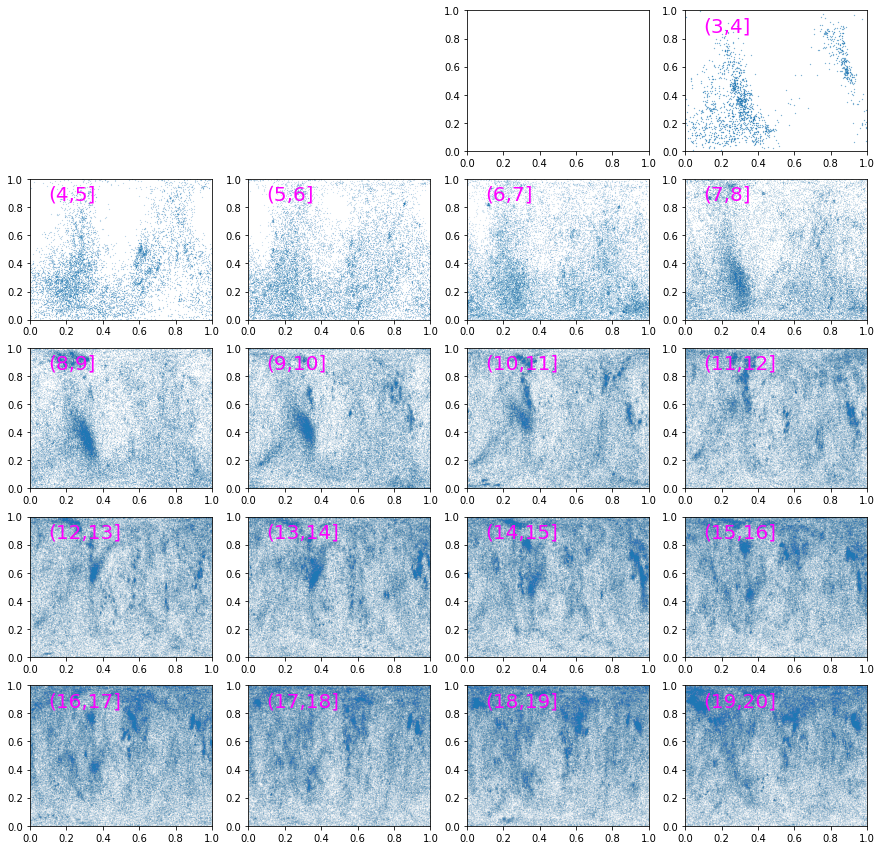

Got 2464882 values of 47916041 for protein type 6 (GLU)
Distance (3;4]: 1379 values bins [483 291  59 193  13   2  20 127 191] p-value 2.484653832215868e-277
Distance (4;5]: 6928 values bins [1902 1221  573 1019  566  223  340  595  489] p-value 0.0
Distance (5;6]: 18941 values bins [3294 2492 1570 2714 1989 2585 1387 1829 1081] p-value 0.0
Distance (6;7]: 32619 values bins [4650 3589 3628 4348 2972 4340 3982 2849 2261] p-value 1.1533501849910938e-298
Distance (7;8]: 51698 values bins [8518 4625 6236 6237 4286 6223 7384 3834 4355] p-value 0.0
Distance (8;9]: 76726 values bins [11034  6729  9821  8597  7209  9991  9846  5666  7833] p-value 0.0
Distance (9;10]: 100004 values bins [11251  8712 13385 10021 11206 13137 13087  8267 10938] p-value 0.0
Distance (10;11]: 123756 values bins [11708 11769 18273 11420 13733 16812 13395 11468 15178] p-value 0.0
Distance (11;12]: 146941 values bins [14186 15337 23793 12018 15039 19849 14905 13393 18421] p-value 0.0
Distance (12;13]: 161129 values bin

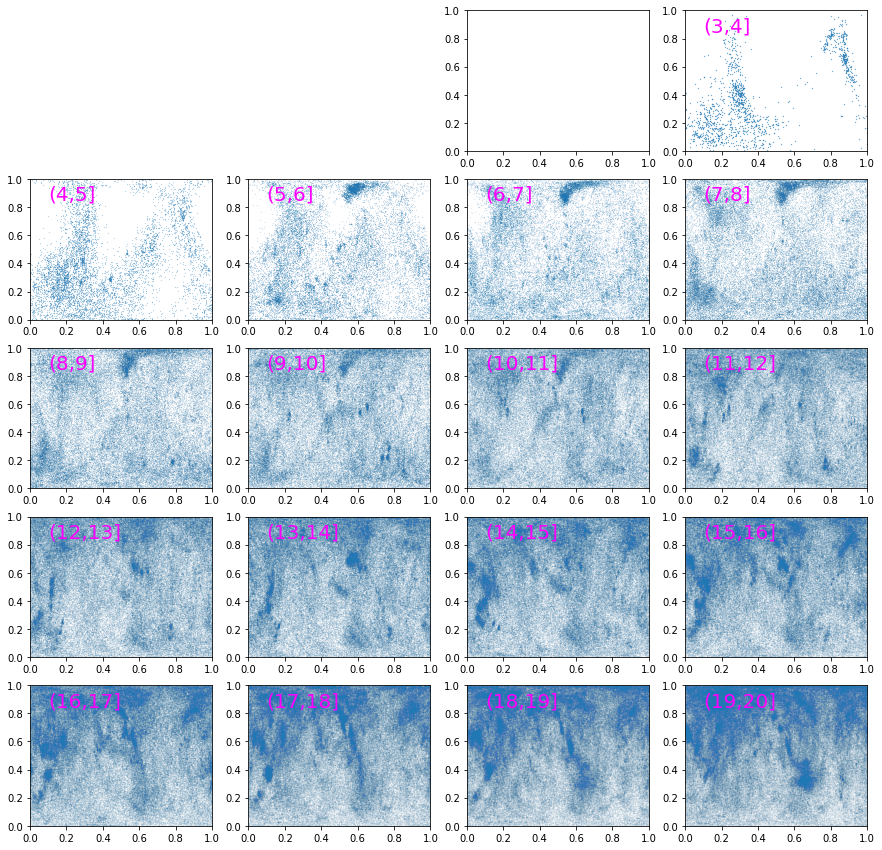

Got 2501822 values of 47916041 for protein type 3 (ASP)
Distance (2;3]: 17 values bins [8 6 0 2 0 0 0 0 1] p-value 5.859838079047278e-06
Distance (3;4]: 3553 values bins [1244  588   60  301   52    2   42  474  790] p-value 0.0
Distance (4;5]: 13699 values bins [2754 1239  354 1570  663  130 1577 2490 2922] p-value 0.0
Distance (5;6]: 32311 values bins [4433 2010  795 6243 1735  763 5985 5247 5100] p-value 0.0
Distance (6;7]: 50236 values bins [ 5865  3461  1702  9621  2453  1561 10850  6783  7940] p-value 0.0
Distance (7;8]: 72462 values bins [ 8341  5630  3892 12112  4589  3142 15015  9766  9975] p-value 0.0
Distance (8;9]: 100794 values bins [10472  8614  7497 14749  7904  5849 17976 14337 13396] p-value 0.0
Distance (9;10]: 124757 values bins [11835 10658 11003 16638 12920  9089 19446 16002 17166] p-value 0.0
Distance (10;11]: 147144 values bins [12187 12200 14521 18362 14990 12086 22067 18512 22219] p-value 0.0
Distance (11;12]: 159628 values bins [12394 12782 17030 19064 16936 1

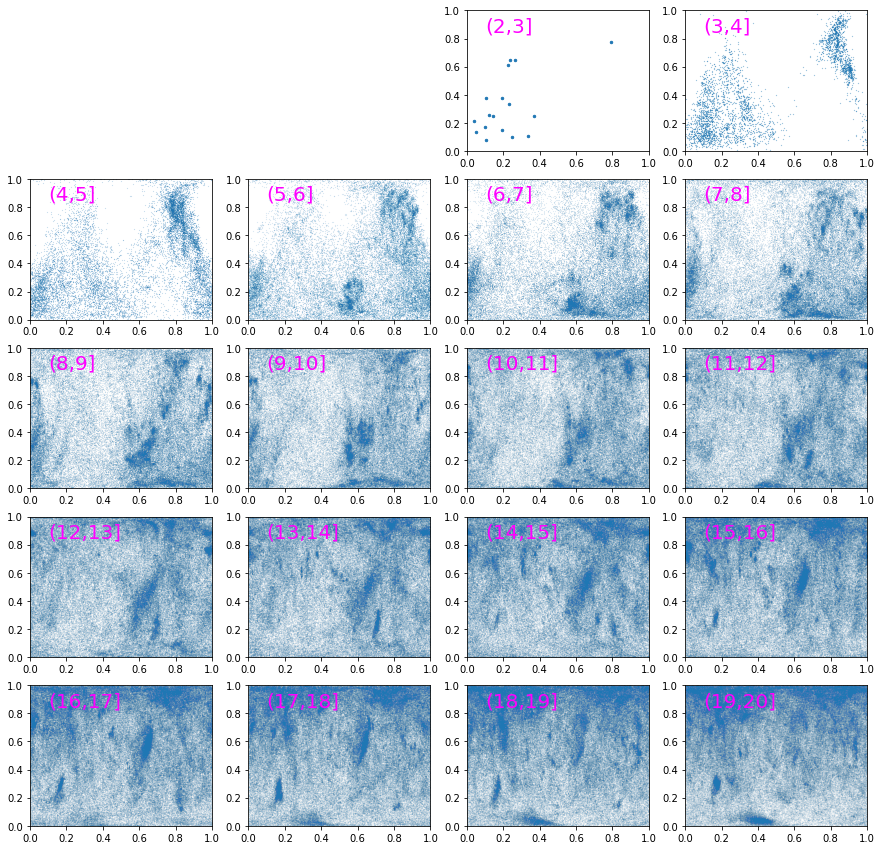

Got 2688850 values of 47916041 for protein type 16 (THR)
Distance (2;3]: 83 values bins [11  7  2  8  0  0 20 33  2] p-value 4.662792047003897e-19
Distance (3;4]: 3253 values bins [840 337 129 531  50   4  47 759 556] p-value 0.0
Distance (4;5]: 13993 values bins [3750 1475  909 1612  749  152  819 2557 1970] p-value 0.0
Distance (5;6]: 31368 values bins [4656 3220 1932 3860 1903 1031 5041 6706 3019] p-value 0.0
Distance (6;7]: 48335 values bins [4678 4871 4348 6369 2817 2569 9296 8315 5072] p-value 0.0
Distance (7;8]: 62207 values bins [ 5765  5681  7185  7802  4671  4396 10347  8927  7433] p-value 0.0
Distance (8;9]: 92584 values bins [ 7674  8112 13260 10075  7809 11522 12791 11036 10305] p-value 0.0
Distance (9;10]: 122569 values bins [ 9352 11084 20951 12075 11017 15912 14476 13546 14156] p-value 0.0
Distance (10;11]: 149680 values bins [10551 16179 24629 15456 15238 17477 15761 15776 18613] p-value 0.0
Distance (11;12]: 170116 values bins [12071 18613 26782 16168 17796 19803 1650

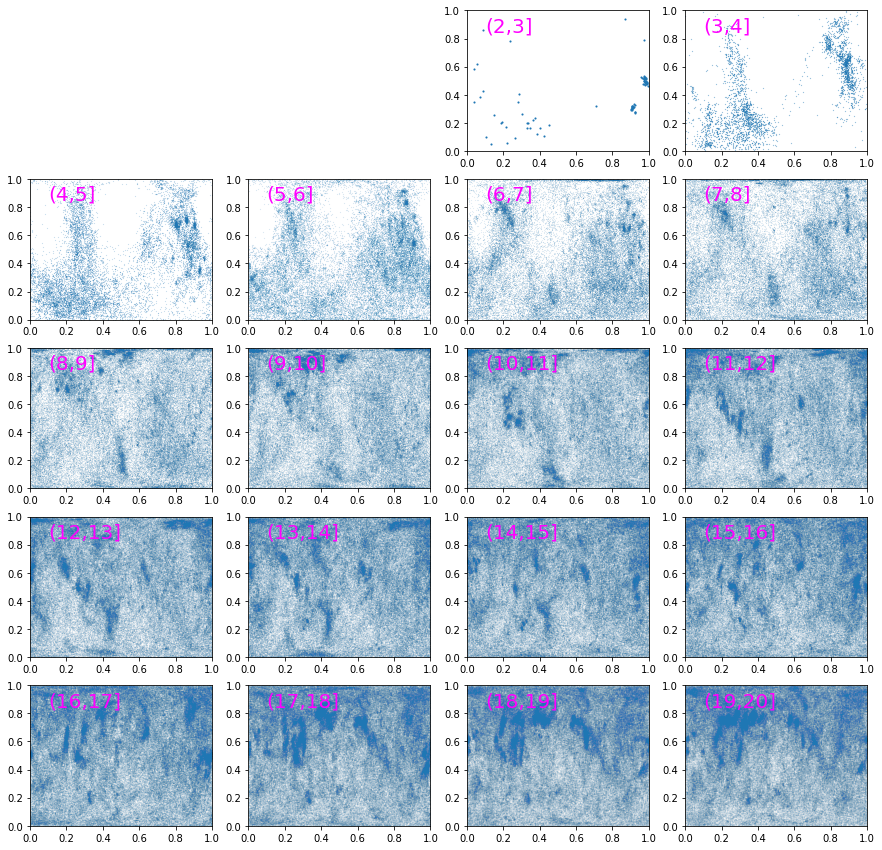

Got 2871018 values of 47916041 for protein type 15 (SER)
Distance (2;3]: 24 values bins [6 1 0 8 1 0 5 2 1] p-value 0.0012784041168759218
Distance (3;4]: 4247 values bins [1099  391  104 1018   67    1  236  844  487] p-value 0.0
Distance (4;5]: 17706 values bins [4419 1293  725 2758 1065  431 2918 2190 1907] p-value 0.0
Distance (5;6]: 36736 values bins [6072 2757 2119 4727 2593 2972 7504 4921 3071] p-value 0.0
Distance (6;7]: 52597 values bins [ 6967  4763  3706  6015  4102  5438 10274  6716  4616] p-value 0.0
Distance (7;8]: 72776 values bins [ 9886  6458  7067  6817  6443  8099 12345  8629  7032] p-value 0.0
Distance (8;9]: 106208 values bins [12586  9328 11938  9001 11233 14055 15164 12642 10261] p-value 0.0
Distance (9;10]: 135513 values bins [14375 13015 16278 11391 14765 16506 18234 16731 14218] p-value 0.0
Distance (10;11]: 157776 values bins [14638 15669 18935 14268 17545 17941 20434 19657 18689] p-value 0.0
Distance (11;12]: 179675 values bins [15953 18318 22844 17123 20038 

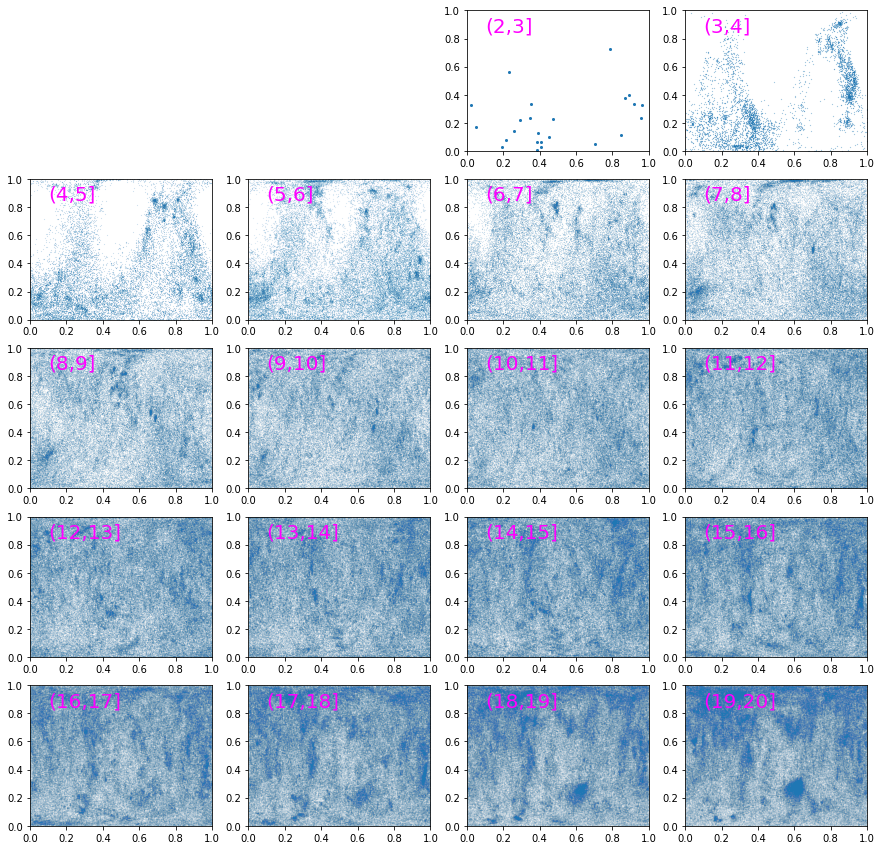

Got 3949422 values of 47916041 for protein type 7 (GLY)
Distance (2;3]: 225 values bins [27 30 12 55  4  1 59 28  9] p-value 1.1904726035671367e-26
Distance (3;4]: 23695 values bins [5626 2171 1013 4544  673    3 4518 4175  972] p-value 0.0
Distance (4;5]: 53686 values bins [10674  4451  3139  9256  4522   674  9668  7811  3491] p-value 0.0
Distance (5;6]: 77243 values bins [11195  6247  6576 13593  7955  5079 11555  9478  5565] p-value 0.0
Distance (6;7]: 101727 values bins [10738  8626  9556 14936 10059 10240 15409 13074  9089] p-value 0.0
Distance (7;8]: 139925 values bins [12439 11065 14284 19237 12230 13657 21241 21061 14711] p-value 0.0
Distance (8;9]: 182002 values bins [17505 15265 20147 20086 14928 14799 25691 29088 24493] p-value 0.0
Distance (9;10]: 226057 values bins [22327 18155 25666 21523 19342 21593 27456 35407 34588] p-value 0.0
Distance (10;11]: 260967 values bins [22952 20611 31639 24214 23566 26974 27803 40117 43091] p-value 0.0
Distance (11;12]: 275739 values bins 

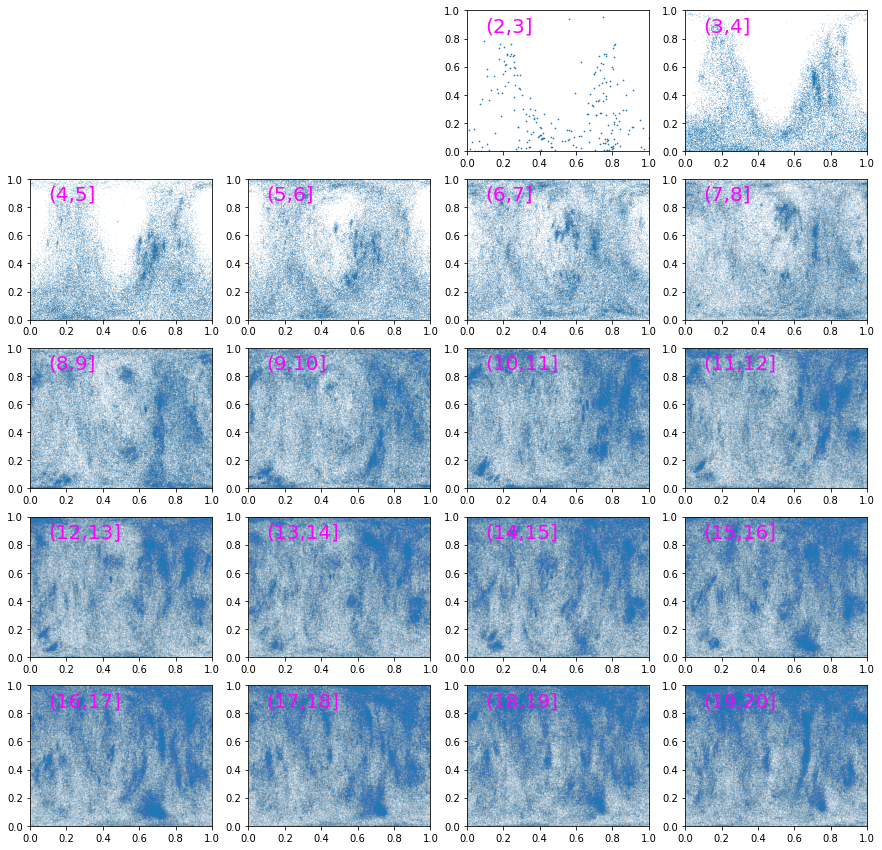

In [116]:
# long and positively charged
plot_for_protein(amino_res_types.index('ARG'))
plot_for_protein(amino_res_types.index('LYS'))
# long
plot_for_protein(amino_res_types.index('GLN'))
plot_for_protein(amino_res_types.index('ASN'))
# negatively charged, close to GLN and ASN
plot_for_protein(amino_res_types.index('GLU'))
plot_for_protein(amino_res_types.index('ASP'))
# short
plot_for_protein(amino_res_types.index('THR'))
plot_for_protein(amino_res_types.index('SER'))
plot_for_protein(amino_res_types.index('GLY'))

Got 3612510 values of 47916041 for protein type 20 (VAL)
Distance (3;4]: 1748 values bins [534 199 126 282  40   0   3 115 449] p-value 0.0
Distance (4;5]: 8808 values bins [2390 1013  898 1209  485  118  212 1093 1390] p-value 0.0
Distance (5;6]: 33062 values bins [4271 2131 1646 5536 2672 1076 7699 5644 2387] p-value 0.0
Distance (6;7]: 63882 values bins [ 4914  3560  3266 10661  4165  2163 22367  8557  4229] p-value 0.0
Distance (7;8]: 90108 values bins [ 6873  6241 10201 15682  9877  4653 21304  9073  6204] p-value 0.0
Distance (8;9]: 131021 values bins [10154 10695 19683 15656 16568 10721 23106 12962 11476] p-value 0.0
Distance (9;10]: 171699 values bins [13429 15448 24266 14566 22608 18133 26131 21550 15568] p-value 0.0
Distance (10;11]: 200392 values bins [14762 18239 26554 16576 28344 21901 26871 25019 22126] p-value 0.0
Distance (11;12]: 223927 values bins [17052 21894 28287 19047 32610 25047 27314 24857 27819] p-value 0.0
Distance (12;13]: 247910 values bins [20781 26124 2895

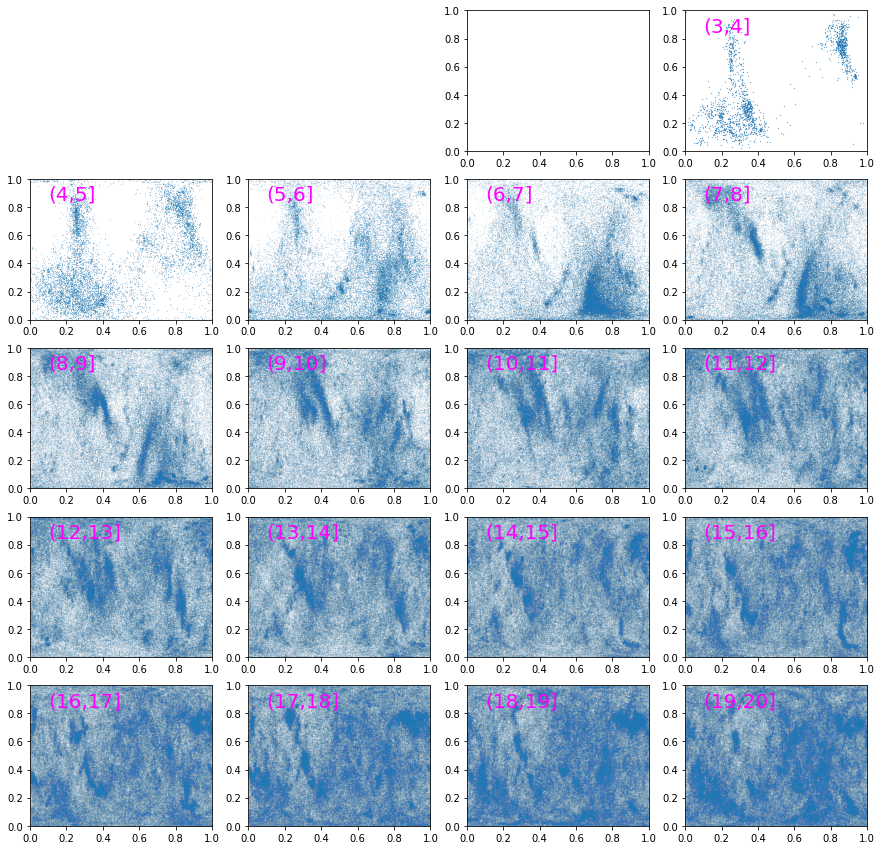

Got 4719938 values of 47916041 for protein type 10 (LEU)
Distance (2;3]: 12 values bins [6 1 0 2 0 0 1 0 2] p-value 0.0040691501559517885
Distance (3;4]: 3052 values bins [676 483  57 799 142   2  21 206 666] p-value 0.0
Distance (4;5]: 15966 values bins [2646 1763  558 4685 2160  152  673 1500 1829] p-value 0.0
Distance (5;6]: 35035 values bins [ 5517  2518  1190 10495  4674  1283  2813  4202  2343] p-value 0.0
Distance (6;7]: 64743 values bins [ 9546  4247  2974 14518  6020  2756 14769  6157  3756] p-value 0.0
Distance (7;8]: 108260 values bins [15284  7068  8921 16929  7785  5680 30433  9365  6795] p-value 0.0
Distance (8;9]: 154292 values bins [20075 14063 21899 16399 11645 13028 27966 15145 14072] p-value 0.0
Distance (9;10]: 204128 values bins [22369 19231 34458 18002 17776 20323 29956 21808 20205] p-value 0.0
Distance (10;11]: 239956 values bins [24420 25719 38844 19810 21757 23810 32014 26215 27367] p-value 0.0
Distance (11;12]: 283686 values bins [26349 33082 38743 22459 28107

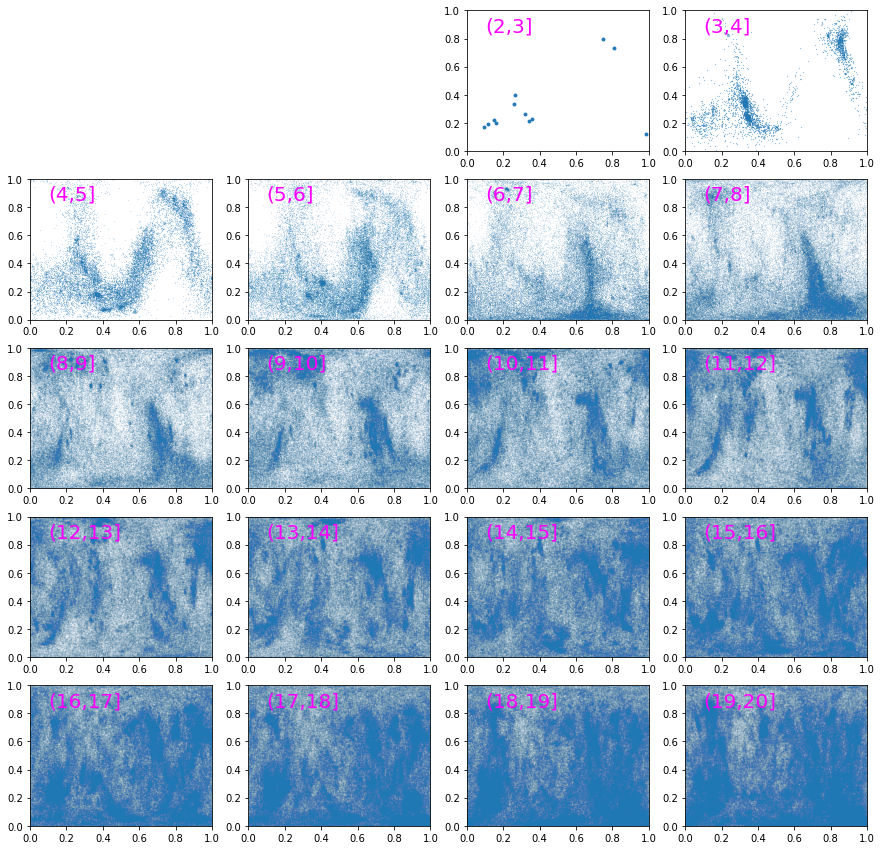

Got 3180106 values of 47916041 for protein type 9 (ILE)
Distance (3;4]: 1577 values bins [454 226  44 370  40   1  11 107 324] p-value 9.110596058409464e-288
Distance (4;5]: 8842 values bins [2382 1235  569 2019  393   91  366 1009  778] p-value 0.0
Distance (5;6]: 25936 values bins [3983 2103  993 7026 2462  901 2917 3452 2099] p-value 0.0
Distance (6;7]: 51016 values bins [ 4485  3373  2530 11389  4401  2017 12943  6641  3237] p-value 0.0
Distance (7;8]: 76464 values bins [ 5431  5260  9272 10587  7006  3615 19889 10095  5309] p-value 0.0
Distance (8;9]: 112520 values bins [ 8317 10023 19682 10803 10413  9533 21084 13040  9625] p-value 0.0
Distance (9;10]: 151841 values bins [11110 13673 29715 12190 15209 18433 19952 17651 13908] p-value 0.0
Distance (10;11]: 178021 values bins [13396 15303 33010 14482 22486 20045 20764 18911 19624] p-value 0.0
Distance (11;12]: 196428 values bins [14896 18118 31152 15647 28911 20629 23287 20971 22817] p-value 0.0
Distance (12;13]: 219247 values bins

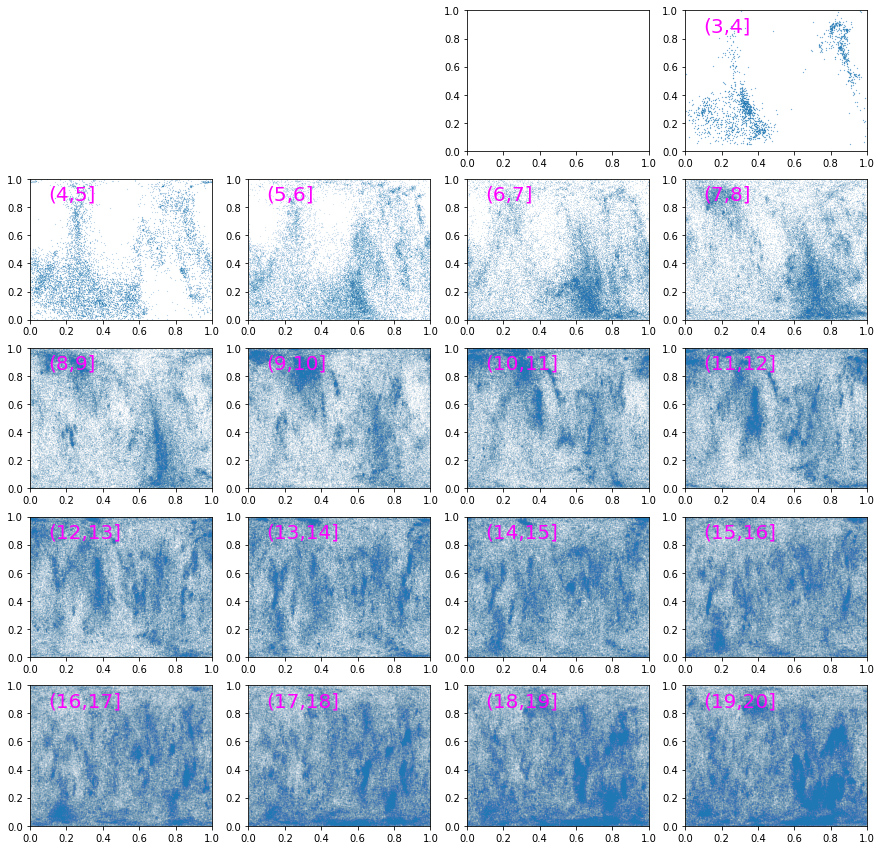

In [123]:
# short and neutral
plot_for_protein(amino_res_types.index('VAL'))
plot_for_protein(amino_res_types.index('LEU'))
plot_for_protein(amino_res_types.index('ILE'))

Got 2249825 values of 47916041 for protein type 13 (PHE)
Distance (3;4]: 2070 values bins [712 503  65 410  29   1  23  97 230] p-value 0.0
Distance (4;5]: 9590 values bins [2656 1641  636 1641  498   88  976  675  779] p-value 0.0
Distance (5;6]: 22884 values bins [4382 2539 1280 3645 1390  805 5081 2104 1658] p-value 0.0
Distance (6;7]: 35015 values bins [5664 3772 2502 4984 2262 1628 7895 3370 2938] p-value 0.0
Distance (7;8]: 53414 values bins [8566 5767 6096 7279 3845 2707 9778 5029 4347] p-value 0.0
Distance (8;9]: 86141 values bins [13669 10525 12073 10901  6140  5026 13368  7818  6621] p-value 0.0
Distance (9;10]: 110394 values bins [17754 13714 14403 11542  8423  7878 15622 11362  9696] p-value 0.0
Distance (10;11]: 126998 values bins [17893 15321 16961 12597 11147  9936 15657 13884 13602] p-value 0.0
Distance (11;12]: 145646 values bins [16853 18130 19226 14578 13694 12491 16728 17312 16634] p-value 0.0
Distance (12;13]: 162284 values bins [16593 21719 18329 16898 15327 15805

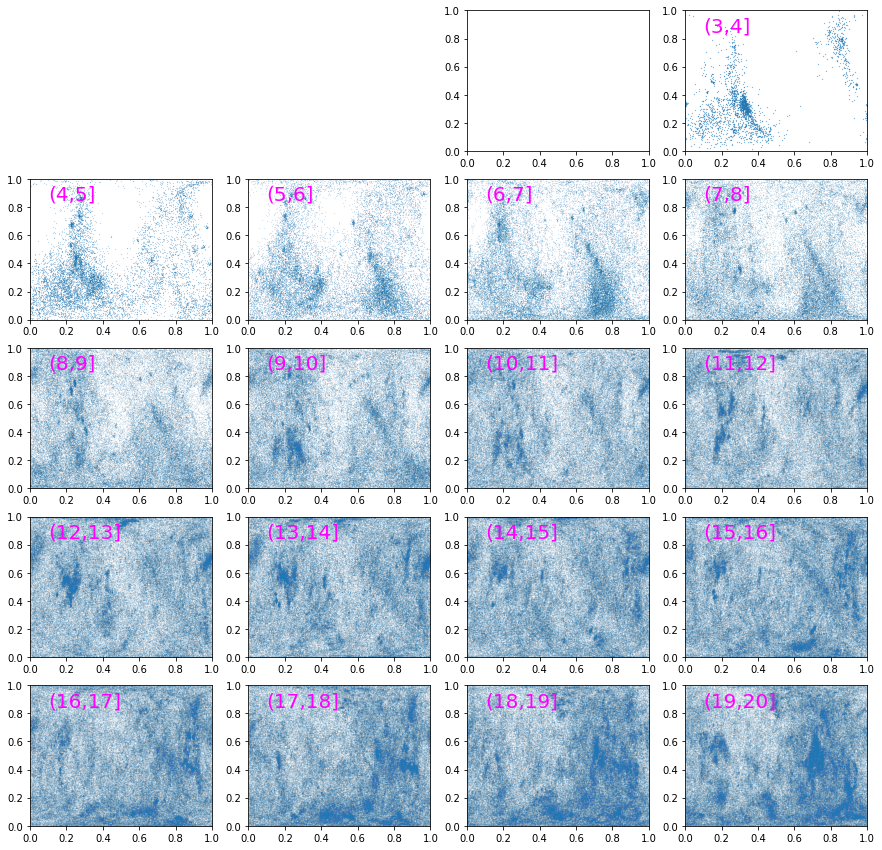

Got 2131879 values of 47916041 for protein type 18 (TYR)
Distance (3;4]: 2605 values bins [993 649  33 515 120   1  24 112 158] p-value 0.0
Distance (4;5]: 10542 values bins [2871 1606  351 2145  692   75 1281  990  531] p-value 0.0
Distance (5;6]: 24037 values bins [4197 2112  716 4875 1211  568 6875 2585  898] p-value 0.0
Distance (6;7]: 33833 values bins [ 5033  2840  1453  5716  1941  1359 10495  3501  1495] p-value 0.0
Distance (7;8]: 55002 values bins [ 8417  4098  5086  8218  4197  2427 13864  5481  3214] p-value 0.0
Distance (8;9]: 84970 values bins [11898  6907 12388 10845  6134  5077 17698  8139  5884] p-value 0.0
Distance (9;10]: 104639 values bins [13116 10027 12151 13735  8082  7197 19462 11606  9263] p-value 0.0
Distance (10;11]: 120427 values bins [13433 11872 12388 13658 10702  9140 21540 14327 13367] p-value 0.0
Distance (11;12]: 137740 values bins [13620 13272 13341 14139 13525 11781 22848 17326 17888] p-value 0.0
Distance (12;13]: 154051 values bins [15186 15563 1369

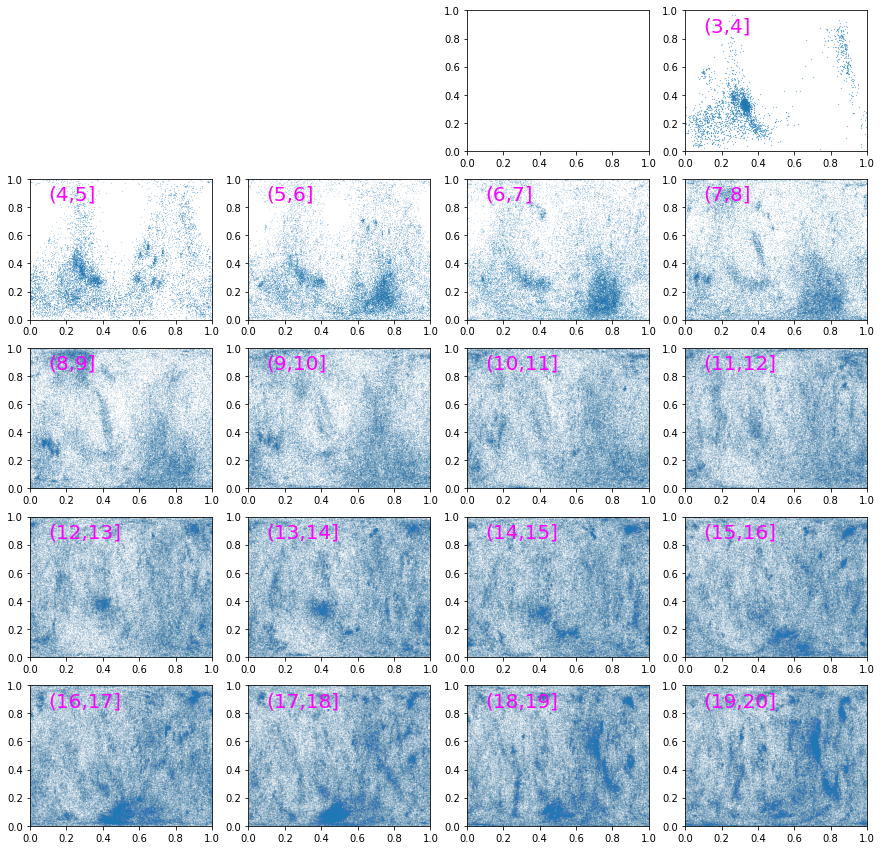

In [114]:
# heteroaromatic
plot_for_protein(amino_res_types.index('PHE'))
plot_for_protein(amino_res_types.index('TYR'))

Got 1268928 values of 47916041 for protein type 8 (HIS)
Distance (3;4]: 1155 values bins [425 170  63 330  22   3  10  27 105] p-value 1.629622331240225e-308
Distance (4;5]: 6388 values bins [1605  671  765 1302  587  149  572  417  320] p-value 0.0
Distance (5;6]: 13826 values bins [2436  978 1118 2248 1264  874 3208 1039  661] p-value 0.0
Distance (6;7]: 22756 values bins [3611 1464 1709 3416 2493 1564 5579 1972  948] p-value 0.0
Distance (7;8]: 36484 values bins [5025 2225 3207 5740 3622 2090 8308 4224 2043] p-value 0.0
Distance (8;9]: 50169 values bins [ 6750  3224  5371  6743  4785  3801 10018  6296  3181] p-value 0.0
Distance (9;10]: 64142 values bins [ 7722  4782  6605  7811  6566  5232 12402  8002  5020] p-value 0.0
Distance (10;11]: 75759 values bins [ 8232  5623  7964  9197  7617  6364 14141 10010  6611] p-value 0.0
Distance (11;12]: 81787 values bins [ 7542  6092  8506 10451  8369  6991 14631 11071  8134] p-value 0.0
Distance (12;13]: 86576 values bins [ 8142  7244  8556 121

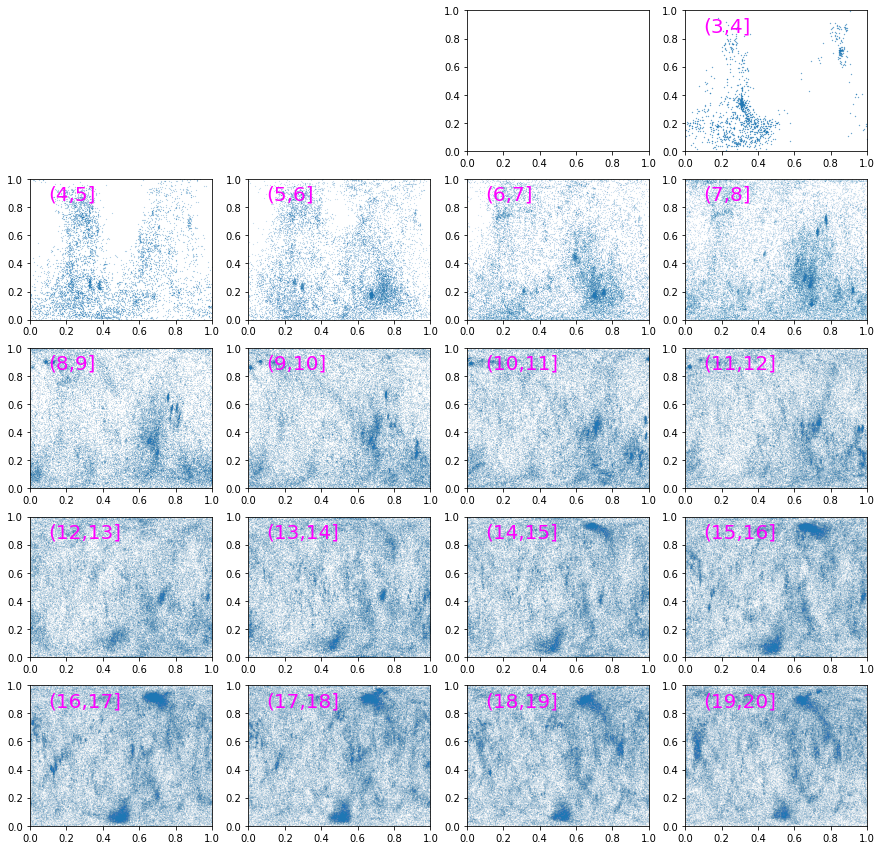

Got 868670 values of 47916041 for protein type 17 (TRP)
Distance (3;4]: 1768 values bins [371 633 187 423  43   0   6  40  65] p-value 0.0
Distance (4;5]: 7658 values bins [1858 1908  466 1370  803  264  466  299  224] p-value 0.0
Distance (5;6]: 13082 values bins [2253  975  371 3045 1107  985 3104  880  362] p-value 0.0
Distance (6;7]: 17744 values bins [2724 1177  510 3753 1278  697 5501 1571  533] p-value 0.0
Distance (7;8]: 23111 values bins [3139 1671 1494 4293 1561 1080 6572 2335  966] p-value 0.0
Distance (8;9]: 32491 values bins [5009 2234 2583 5082 2709 2166 7826 3147 1735] p-value 0.0
Distance (9;10]: 40740 values bins [6237 2964 2978 5608 4121 2916 8488 4880 2548] p-value 0.0
Distance (10;11]: 47927 values bins [6920 3632 3517 5723 5039 3448 8750 7089 3809] p-value 0.0
Distance (11;12]: 54104 values bins [7133 4157 4456 5938 5333 4888 8889 8333 4977] p-value 0.0
Distance (12;13]: 60897 values bins [7350 4776 5776 7001 6063 6369 9031 9103 5428] p-value 0.0
Distance (13;14]: 

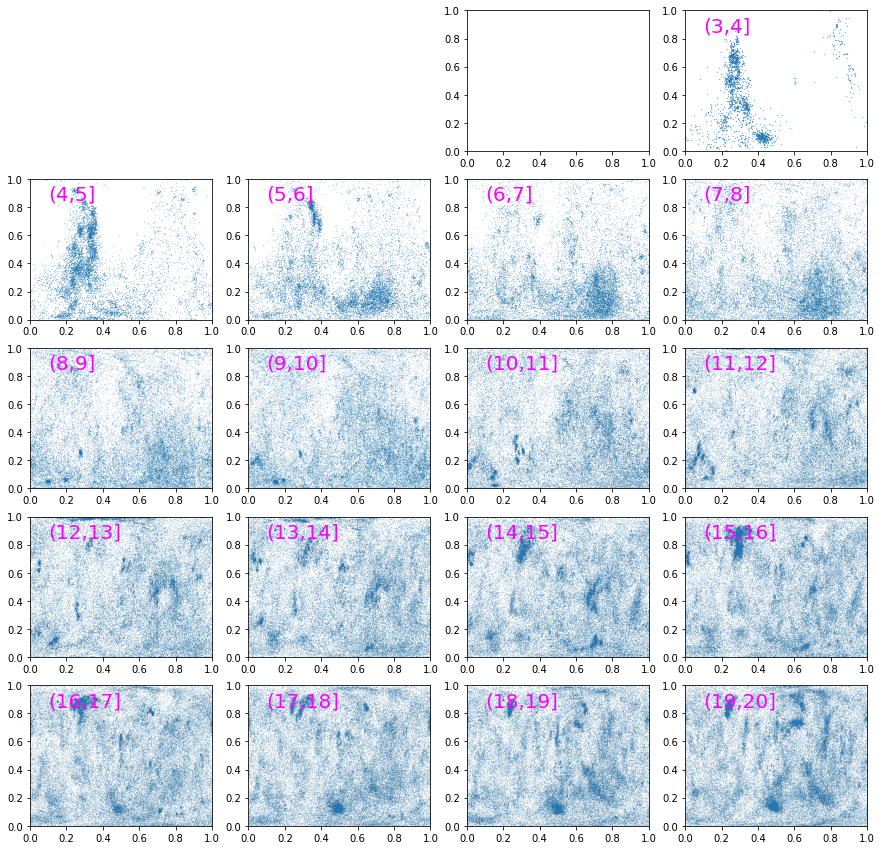

In [117]:
# positively charged aromatic ring (wih two nitrogens)
plot_for_protein(amino_res_types.index('HIS'))
# neutral aromatic ring (2 conjugated rings, 1 with nitrogen)
plot_for_protein(amino_res_types.index('TRP'))

Got 3337419 values of 47916041 for protein type 0 (ALA)
Distance (2;3]: 31 values bins [14  3  0 10  0  0  1  2  1] p-value 6.421252222597127e-10
Distance (3;4]: 5561 values bins [2154  778  116 1299  102    2   77  380  653] p-value 0.0
Distance (4;5]: 27789 values bins [7766 2159  625 5395 1741  263 5184 2435 2221] p-value 0.0
Distance (5;6]: 49251 values bins [ 8889  3354  1423  6587  3463  1686 15414  5334  3101] p-value 0.0
Distance (6;7]: 56915 values bins [ 7866  6025  2791  7960  4502  2649 14622  6476  4024] p-value 0.0
Distance (7;8]: 75815 values bins [10575  8328  6080 10010  6181  4367 15346  8259  6669] p-value 0.0
Distance (8;9]: 109948 values bins [13194 12102 10663 12553 10402  8206 19104 12629 11095] p-value 0.0
Distance (9;10]: 147981 values bins [14828 16248 16275 14528 14920 12989 23264 19001 15928] p-value 0.0
Distance (10;11]: 182343 values bins [15509 19812 20796 17537 17479 16303 24207 25522 25178] p-value 0.0
Distance (11;12]: 210551 values bins [17193 22231 2

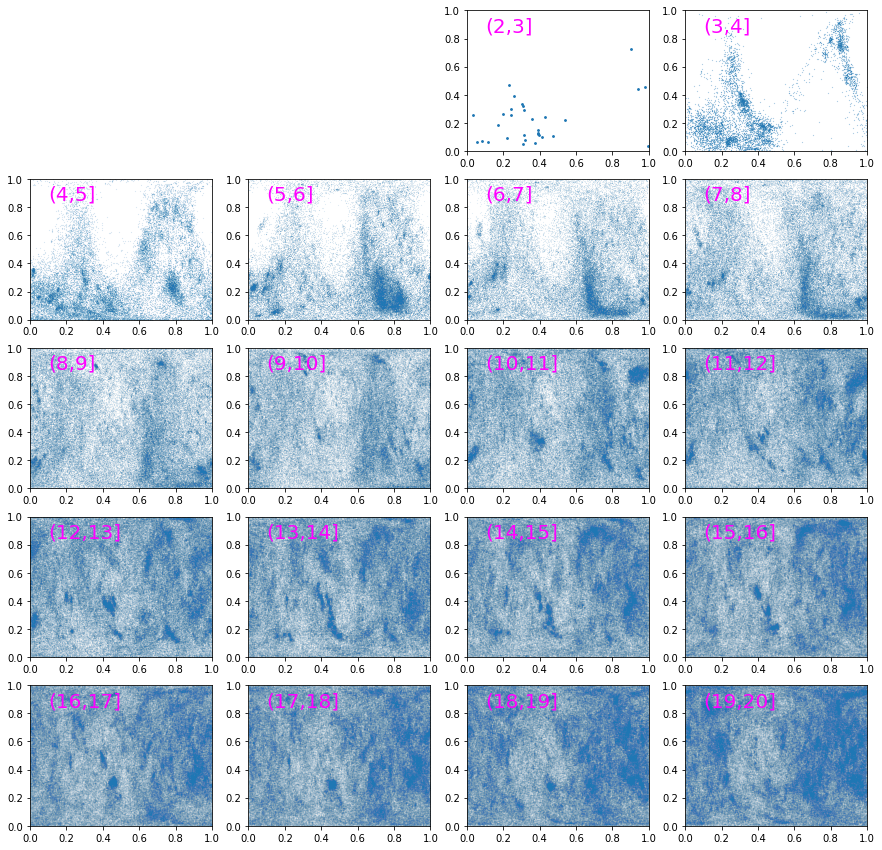

In [124]:
plot_for_protein(amino_res_types.index('ALA'))

Got 944020 values of 47916041 for protein type 4 (CYS)
Distance (3;4]: 2366 values bins [622 667  75 230  40   0 110 304 318] p-value 0.0
Distance (4;5]: 9386 values bins [2062 2806  702 1026  766  104  523  658  739] p-value 0.0
Distance (5;6]: 13990 values bins [3883 1290  587 1854 1264  685 1762 1558 1107] p-value 0.0
Distance (6;7]: 18156 values bins [4140 1779  977 1981 1609  869 3204 2398 1199] p-value 0.0
Distance (7;8]: 25871 values bins [5330 2762 2477 2613 2918 1680 3808 2614 1669] p-value 0.0
Distance (8;9]: 35105 values bins [6294 4215 4661 3607 3478 2482 4251 3625 2492] p-value 0.0
Distance (9;10]: 45309 values bins [8001 5251 5406 4425 4664 4207 5085 4551 3719] p-value 0.0
Distance (10;11]: 52702 values bins [9784 6133 4911 4401 5249 4415 5836 5813 6160] p-value 0.0
Distance (11;12]: 58579 values bins [10776  7188  5018  4783  6412  4706  6409  6906  6381] p-value 0.0
Distance (12;13]: 67055 values bins [12964  8849  5156  6881  8047  5289  6920  6854  6095] p-value 0.0
D

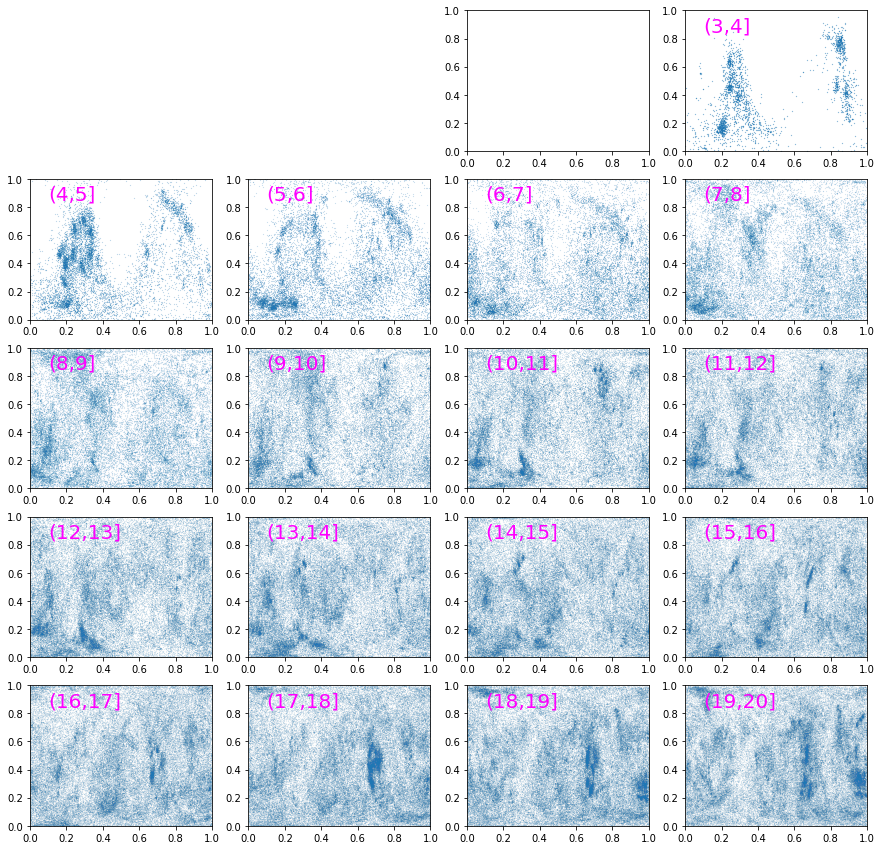

Got 1212218 values of 47916041 for protein type 12 (MET)
Distance (3;4]: 1530 values bins [370 111   9 222  28   0  14  98 678] p-value 0.0
Distance (4;5]: 6262 values bins [1349  565  119  999  511   62  373 1043 1241] p-value 0.0
Distance (5;6]: 12972 values bins [2059  840  406 2034 1115  592 1902 2384 1640] p-value 0.0
Distance (6;7]: 20237 values bins [2973 1443  858 3320 1520 1022 4344 3190 1567] p-value 0.0
Distance (7;8]: 33234 values bins [4953 2520 2595 4480 2405 1791 8174 4414 1902] p-value 0.0
Distance (8;9]: 45360 values bins [5843 3795 4566 5398 3431 3480 9743 6119 2985] p-value 0.0
Distance (9;10]: 56344 values bins [5945 4710 5574 5818 5439 6310 9593 8275 4680] p-value 0.0
Distance (10;11]: 67270 values bins [ 6609  5344  6825  6613  7421  7930 10374  9603  6551] p-value 0.0
Distance (11;12]: 75717 values bins [ 7248  6124  7869  7722  8890  7915 11633 10307  8009] p-value 0.0
Distance (12;13]: 84293 values bins [ 7951  7312  7971  9756  9636  9084 12181 11197  9205] p-

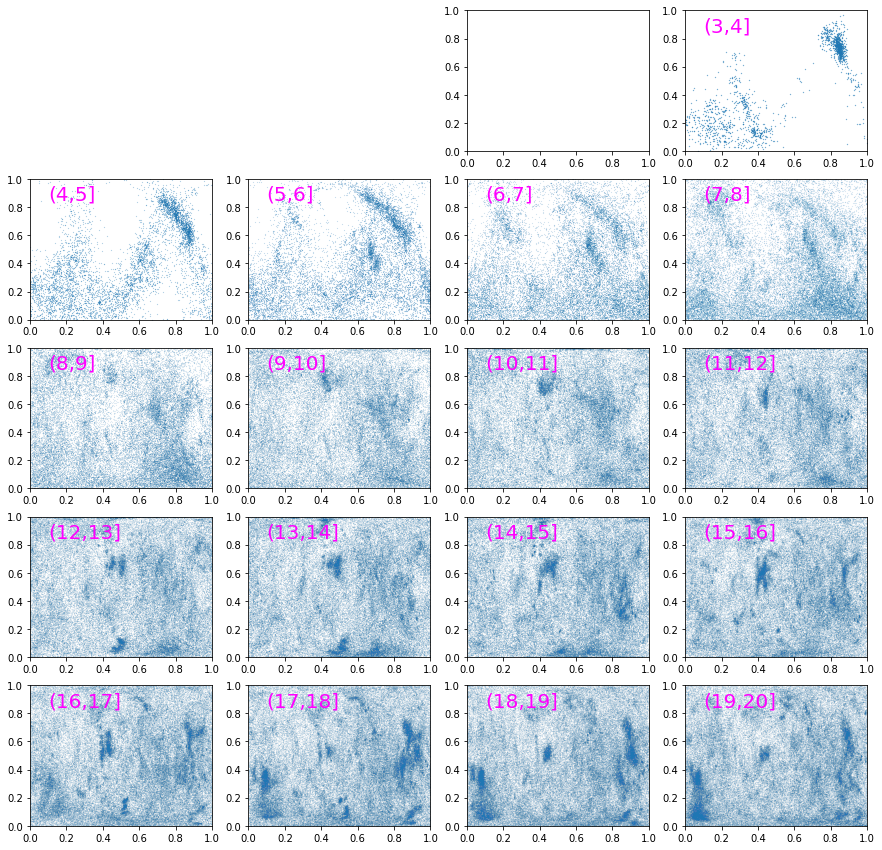

In [122]:
# contain sulfur
plot_for_protein(amino_res_types.index('CYS'))
plot_for_protein(amino_res_types.index('MET'))

Got 1873468 values of 47916041 for protein type 14 (PRO)
Distance (2;3]: 19 values bins [ 3  0 10  2  0  0  2  2  0] p-value 6.581367696075585e-06
Distance (3;4]: 1048 values bins [571 122  17 284  14   0  11   5  24] p-value 0.0
Distance (4;5]: 5479 values bins [1189  767  184 1362  605  123  600  384  265] p-value 0.0
Distance (5;6]: 14669 values bins [1410 1197  719 1846 1501  928 2835 2897 1336] p-value 0.0
Distance (6;7]: 23659 values bins [1982 2063 1611 2414 2053 2630 3223 4527 3156] p-value 0.0
Distance (7;8]: 33014 values bins [3567 3267 3247 2781 2685 4277 3450 4149 5591] p-value 0.0
Distance (8;9]: 51171 values bins [5457 4961 6484 3207 4940 8267 4074 5433 8348] p-value 0.0
Distance (9;10]: 70304 values bins [ 6414  6901  9407  4055  7312 10958  5251  8023 11983] p-value 0.0
Distance (10;11]: 88336 values bins [ 7054  8983 12874  5207  9906 14350  5666  8936 15360] p-value 0.0
Distance (11;12]: 110575 values bins [ 8430 11653 17579  6079 11797 20044  6011  9311 19671] p-valu

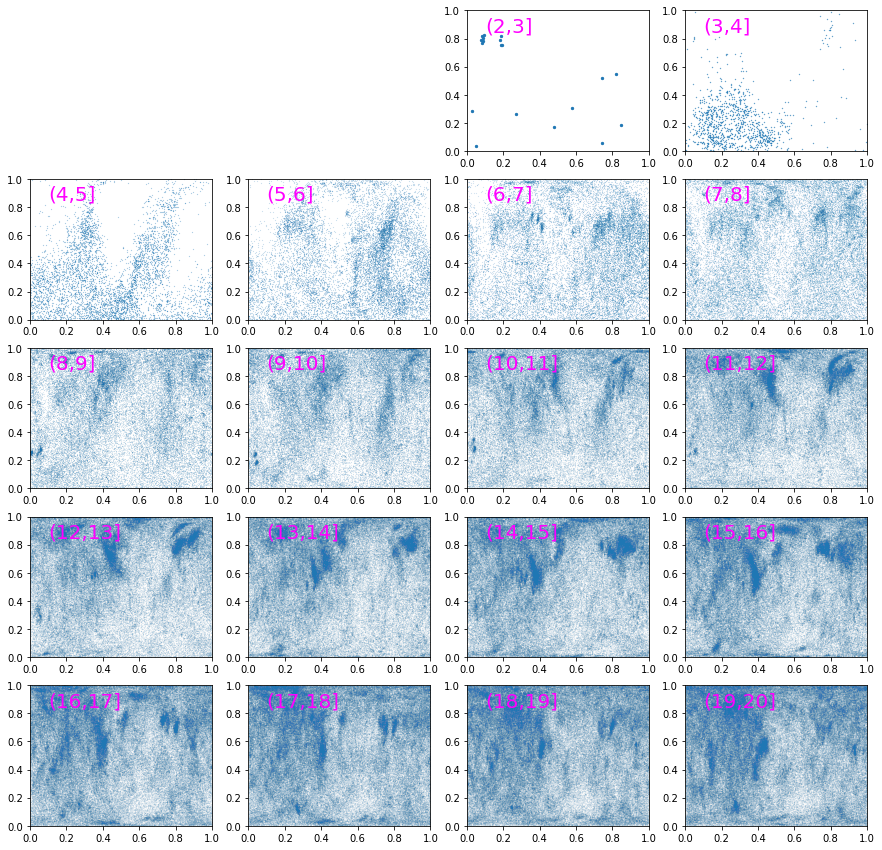

In [113]:
plot_for_protein(amino_res_types.index('PRO'))